In [1]:
import sklearn 

print(sklearn.__version__)

1.2.1


# Problema de Negócio

A Rossmann opera mais de 3.000 drogarias em 7 países europeus. Atualmente, os gerentes de loja da Rossmann têm a tarefa de prever suas vendas diárias com até seis semanas de antecedência. As vendas da loja são influenciadas por muitos fatores, incluindo promoções, concorrência, feriados escolares e estaduais, sazonalidade e localidade. Com milhares de gerentes individuais prevendo vendas com base em suas circunstâncias únicas, a precisão dos resultados pode variar bastante.

# Dicionário de Dados

A maioria dos campos é auto-explicativa. A seguir estão as descrições para aqueles que não são.

* Id - um Id que representa uma duplicata (Store, Date) dentro do conjunto de teste
* Store/Loja  - um ID exclusivo para cada loja
* Sales/Vendas  - o volume de negócios para um determinado dia (isto é o que você está prevendo)
* Customers/Clientes  - o número de clientes em um determinado dia
* Aberto/Open  - um indicador para saber se a loja estava aberta: 0 = fechado, 1 = aberto
* StateHoliday/ - indica um feriado estadual. Normalmente todas as lojas, com poucas exceções, fecham nos feriados estaduais. Observe que todas as escolas fecham nos feriados e fins de semana. a = feriado, b = feriado da Páscoa, c = Natal, 0 = nenhum
* SchoolHoliday - indica se o (Store, Date) foi afetado pelo fechamento das escolas públicas
* StoreType  - diferencia entre 4 modelos de loja diferentes: a, b, c, d
* Assortment/Sortimento - descreve um nível de sortimento: a = básico, b = extra, c = estendido
* CompetitionDistance - distância em metros até a loja concorrente mais próxima
* CompetitionOpenSince[Month/Year] - fornece o ano e o mês aproximados da hora em que o concorrente mais próximo foi aberto
* Promo - indica se uma loja está realizando uma promoção naquele dia
* Promo2 - Promo2 é uma promoção contínua e consecutiva para algumas lojas: 0 = loja não está participando, 1 = loja está participando
* Promo2Since[Year/Week] - descreve o ano e a semana do calendário em que a loja começou a participar do Promo2
* PromoInterval - descreve os intervalos consecutivos em que o Promo2 é iniciado, nomeando os meses em que a promoção é reiniciada. Por exemplo, "fevereiro, maio, agosto, novembro" significa que cada rodada começa em fevereiro, maio, agosto, novembro de qualquer ano para essa loja

competition_distance              2642
competition_open_since_month    323348
competition_open_since_year     323348
promo2                               0
promo2_since_week               508031
promo2_since_year               508031
promo_interval                  508031

# 0.0 Imports

In [2]:
import math
import numpy  as np
import pandas as pd
import random
import datetime 
import pickle
import warnings
import inflection
import seaborn as sns
import xgboost as xgb
import json 
import requests

from scipy                 import stats  as ss
#from boruta                import BorutaPy
from matplotlib            import pyplot as plt
from IPython.display       import Image
from IPython.core.display  import HTML


from sklearn.metrics       import mean_absolute_error, mean_squared_error
from sklearn.ensemble      import RandomForestRegressor
from sklearn.linear_model  import LinearRegression, Lasso
from sklearn.preprocessing import RobustScaler, MinMaxScaler, LabelEncoder

warnings.filterwarnings( 'ignore' )

  #  0.1 Helper Functions

In [3]:
def cross_validation(xtraining,kfold,model_name,model,verbose=False):
    mae_list = []
    mape_list = []
    rmse_list = []
    for k in reversed(range(1,kfold+1)): 
        if verbose:
            print("\nKfold Number: {}".format(k))
        # start and end date for validation
        validation_start_date= x_training["date"].max() - datetime.timedelta(days=k *6 *7)
        validation_end_date = x_training["date"].max() - datetime.timedelta(days=(k-1) *6 *7)
        # filtering dataset
        training = x_training[x_training["date"] < validation_start_date]
        validation = x_training[(x_training["date"] >= validation_start_date) & (x_training["date"] <= validation_end_date)]
        # training and validation 
        xtraining = training.drop(["date","sales"],axis=1)
        ytraining = training["sales"]
        xvalidation = validation.drop(["date","sales"],axis=1)
        yvalidation = validation["sales"]

        m = model.fit(xtraining,ytraining)
        yhat = m.predict(xvalidation)
        m_result = ml_error(model_name,np.expm1(yvalidation),np.expm1(yhat))
        mae_list.append(m_result["MAE"])
        mape_list.append(m_result["MAPE"])
        rmse_list.append(m_result["RMSE"])
        return pd.DataFrame({"MAE_CV":np.round(np.mean(m_result["MAE"]),2).astype(str) + "+/-" + np.round(np.std(m_result["MAE"]),2).astype(str),
                          "MAPE_CV":np.round(np.mean(m_result["MAPE"]),2).astype(str) + "+/-" + np.round(np.std(m_result["MAPE"]),2).astype(str),
                          "RMSE_CV":np.round(np.mean(m_result["RMSE"]),2).astype(str) + "+/-" + np.round(np.std(m_result["RMSE"]),2).astype(str)},index=[0])

def mean_percentage_error( y, yhat ):
    return np.mean( ( y - yhat ) / y )

def mean_absolute_percentage_error(y,yhat):
    return np.mean(np.abs((y - yhat)/ y))


def ml_error(model_name,y,yhat):
    mae =  mean_absolute_error(y,yhat)
    mape = mean_absolute_percentage_error(y,yhat)
    rmse = np.sqrt(mean_squared_error(y,yhat))
    return pd.DataFrame({"Model Name":model_name,
                        "MAE":mae,
                         "MAPE":mape,
                        "RMSE":rmse},index=[0])
def cramer_v( x, y ):
    cm = pd.crosstab( x, y ).values
    n = cm.sum()
    r, k = cm.shape
    
    chi2 = ss.chi2_contingency( cm )[0]
    chi2corr = max( 0, chi2 - (k-1)*(r-1)/(n-1) )
    
    kcorr = k - (k-1)**2/(n-1)
    rcorr = r - (r-1)**2/(n-1)
    
    return np.sqrt( (chi2corr/n) / ( min( kcorr-1, rcorr-1 ) ) )

def jupyter_settings():
    %matplotlib inline
    %pylab inline
    
    plt.style.use( 'bmh' )
    plt.rcParams['figure.figsize'] = [25, 12]
    plt.rcParams['font.size'] = 24
    
    display( HTML( '<style>.container { width:100% !important; }</style>') )
    pd.options.display.max_columns = None
    pd.options.display.max_rows = None
    pd.set_option( 'display.expand_frame_repr', False )    
    sns.set()

In [4]:
jupyter_settings()

%pylab is deprecated, use %matplotlib inline and import the required libraries.
Populating the interactive namespace from numpy and matplotlib


 #   02. Loading Data 

In [5]:
df_sales_raw = pd.read_csv(r"C:\Users\Douglas\Documents\repos\datascience_em_producao\data\train.csv" ,low_memory=False) 
df_store_raw = pd.read_csv(r"C:\Users\Douglas\Documents\repos\datascience_em_producao\data\store.csv", low_memory=False)

In [6]:
df_raw = pd.merge(df_sales_raw, df_store_raw,how="left",on="Store")
df_raw.head(2)

,Store,DayOfWeek,Date,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday,StoreType,Assortment,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval
0,1,5,2015-07-31,5263,555,1,1,0,1,c,a,1270.0,9.0,2008.0,0,NaN,NaN,NaN
1,2,5,2015-07-31,6064,625,1,1,0,1,a,a,570.0,11.0,2007.0,1,13.0,2010.0,"Jan,Apr,Jul,Oct"


# 1.0 DESCRIÇÃO DOS DADOS

In [7]:
df1 = df_raw.copy()

## 1.1 Rename Columns

In [8]:
cols_old = ['Store', 'DayOfWeek', 'Date', 'Sales', 'Customers', 'Open', 'Promo',
       'StateHoliday', 'SchoolHoliday', 'StoreType', 'Assortment',
       'CompetitionDistance', 'CompetitionOpenSinceMonth',
       'CompetitionOpenSinceYear', 'Promo2', 'Promo2SinceWeek',
       'Promo2SinceYear', 'PromoInterval']
snakecase = lambda x : inflection.underscore(x)
cols_new = list(map(snakecase,cols_old))


In [9]:
df1.columns= cols_new
df1.head(2)

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,promo2,promo2_since_week,promo2_since_year,promo_interval
0,1,5,2015-07-31,5263,555,1,1,0,1,c,a,1270.0,9.0,2008.0,0,NaN,NaN,NaN
1,2,5,2015-07-31,6064,625,1,1,0,1,a,a,570.0,11.0,2007.0,1,13.0,2010.0,"Jan,Apr,Jul,Oct"


## 1.2 Data Dimension

In [10]:
print("Number of rows {}".format(df1.shape[0]))
print("Number of columns {}".format(df1.shape[1]))

Number of rows 1017209
Number of columns 18


## 1.3 Data Types

In [11]:
df1.dtypes 

store                             int64
day_of_week                       int64
date                             object
sales                             int64
customers                         int64
open                              int64
promo                             int64
state_holiday                    object
school_holiday                    int64
store_type                       object
assortment                       object
competition_distance            float64
competition_open_since_month    float64
competition_open_since_year     float64
promo2                            int64
promo2_since_week               float64
promo2_since_year               float64
promo_interval                   object
dtype: object

In [12]:
df1.date = pd.to_datetime(df1.date)



## 1.4 Check NAN

In [13]:
df1.isnull().sum()

store                                0
day_of_week                          0
date                                 0
sales                                0
customers                            0
open                                 0
promo                                0
state_holiday                        0
school_holiday                       0
store_type                           0
assortment                           0
competition_distance              2642
competition_open_since_month    323348
competition_open_since_year     323348
promo2                               0
promo2_since_week               508031
promo2_since_year               508031
promo_interval                  508031
dtype: int64

## 1.5 Fillout NAN

In [14]:
# competition_distance ( se a coluna contém valor nan assumimos a premissa que a loja não tem corrente proximo ou a distância é muito grande)
#df1[df1["competition_distance"].isnull()]
#df1["competition_distance"].max()
df1["competition_distance"] = df1["competition_distance"].apply (lambda x: 200000.0 if pd.isna(x) else x)
# competition_open_since_month    
df1["competition_open_since_month"] = df1.apply(lambda x: x["date"].month if pd.isnull(x["competition_open_since_month"]) else x["competition_open_since_month"],axis=1)
# competition_open_since_year     
df1["competition_open_since_year"] = df1.apply(lambda x: x["date"].year if pd.isnull(x["competition_open_since_year"]) else x["competition_open_since_year"],axis=1)
# promo2_since_week 
df1["promo2_since_week"] = df1.apply(lambda x: x["date"].week if pd.isnull(x["promo2_since_week"]) else x["promo2_since_week"],axis=1)
# promo2_since_year   
df1["promo2_since_year"] = df1.apply(lambda x: x["date"].year if pd.isnull(x["promo2_since_year"]) else x["promo2_since_year"],axis=1) 
# promo_interval                 
month_map = {1:"Jan",2:"Fev",3:"Mar",4:"Apr",5:"May",6:"Jun",7:"Jul",8:"Aug",9:"Sept",10:"Oct",11:"Nov",12:"Dec"}
df1["promo_interval"].fillna(0,inplace=True)
df1["month_map"] = df1["date"].dt.month.map(month_map)
df1["is_promo"] = df1[["promo_interval","month_map"]].apply(lambda x: 0 if x["promo_interval"] ==0 else 1 if x["month_map"] in x["promo_interval"].split(",") else 0,axis=1)


In [15]:
df1.dtypes 

store                                    int64
day_of_week                              int64
date                            datetime64[ns]
sales                                    int64
customers                                int64
open                                     int64
promo                                    int64
state_holiday                           object
school_holiday                           int64
store_type                              object
assortment                              object
competition_distance                   float64
competition_open_since_month           float64
competition_open_since_year            float64
promo2                                   int64
promo2_since_week                      float64
promo2_since_year                      float64
promo_interval                          object
month_map                               object
is_promo                                 int64
dtype: object

## 1.6 Change Data Types

In [16]:
# competiton
colunas =["competition_open_since_month","competition_open_since_year","promo2_since_week","promo2_since_year"]
for coluna in colunas:
    df1[coluna] = df1[coluna].astype(int)
# promo2
df1['promo2_since_week'] = df1['promo2_since_week'].astype( int )
df1['promo2_since_year'] = df1['promo2_since_year'].astype( int )    

In [17]:
df1.to_csv("dataset_clean.csv",index=False)

## 1.7. Descriptive Statistics

In [18]:
num_attributes = df1.select_dtypes(include=["float","int"])
cat_attributes = df1.select_dtypes(include=["float","int"])

In [19]:
# Central Tendency - mean, meadina
ct1 = pd.DataFrame( num_attributes.apply( np.mean ) ).T
ct2 = pd.DataFrame( num_attributes.apply( np.median ) ).T
# dispersion - std, min, max, range, skew, kurtosis
d1 = pd.DataFrame( num_attributes.apply( np.std ) ).T
d2 = pd.DataFrame( num_attributes.apply( min ) ).T
d3 = pd.DataFrame( num_attributes.apply( max ) ).T
d4 = pd.DataFrame( num_attributes.apply( lambda x: x.max() - x.min() ) ).T
d5 = pd.DataFrame( num_attributes.apply( lambda x: x.skew() ) ).T
d6 = pd.DataFrame( num_attributes.apply( lambda x: x.kurtosis() ) ).T
m = pd.concat([d2, d3, d4, ct1, ct2, d1, d5, d6] ).T.reset_index()
m.columns = ['attributes', 'min', 'max', 'range', 'mean', 'median', 'std', 'skew', 'kurtosis']
m   

,attributes,min,max,range,mean,median,std,skew,kurtosis
0,store,1.0,1115.0,1114.0,558.429727,558.0,321.908493,-0.000955,-1.200524
1,day_of_week,1.0,7.0,6.0,3.998341,4.0,1.997390,0.001593,-1.246873
2,sales,0.0,41551.0,41551.0,5773.818972,5744.0,3849.924283,0.641460,1.778375
3,customers,0.0,7388.0,7388.0,633.145946,609.0,464.411506,1.598650,7.091773
4,open,0.0,1.0,1.0,0.830107,1.0,0.375539,-1.758045,1.090723
5,promo,0.0,1.0,1.0,0.381515,0.0,0.485758,0.487838,-1.762018
6,school_holiday,0.0,1.0,1.0,0.178647,0.0,0.383056,1.677842,0.815154
7,competition_distance,20.0,200000.0,199980.0,5935.442677,2330.0,12547.646829,10.242344,147.789712
8,competition_open_since_month,1.0,12.0,11.0,6.786849,7.0,3.311085,-0.042076,-1.232607
9,competition_open_since_year,1900.0,2015.0,115.0,2010.324840,2012.0,5.515591,-7.235657,124.071304


### 1.7.2. Categorical Atributes

In [20]:
cat_attributes.apply( lambda x: x.unique().shape[0] )

store                            1115
day_of_week                         7
sales                           21734
customers                        4086
open                                2
promo                               2
school_holiday                      2
competition_distance              655
competition_open_since_month       12
competition_open_since_year        23
promo2                              2
promo2_since_week                  52
promo2_since_year                   7
is_promo                            2
dtype: int64

<AxesSubplot: xlabel='assortment', ylabel='sales'>

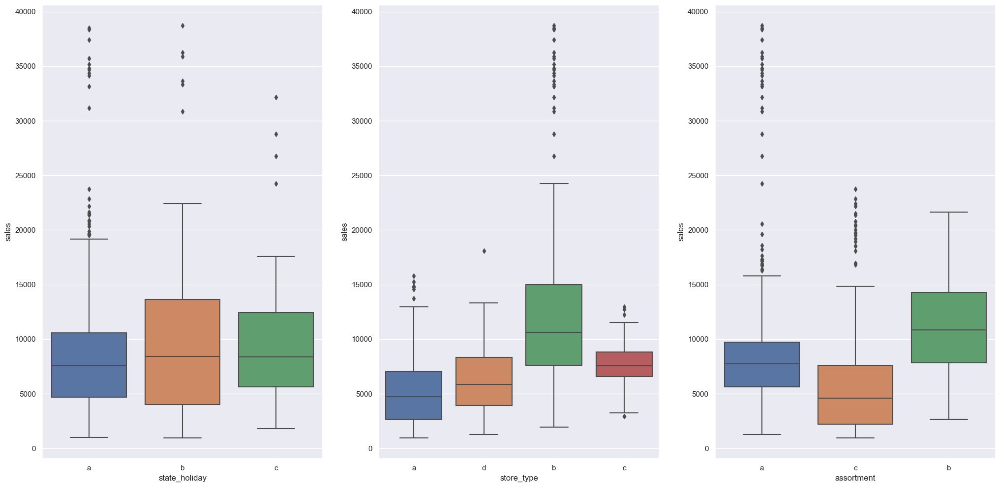

In [21]:
aux = df1[(df1['state_holiday'] != '0') & (df1['sales'] > 0)]

plt.subplot( 1, 3, 1 )
sns.boxplot( x='state_holiday', y='sales', data=aux )

plt.subplot( 1, 3, 2 )
sns.boxplot( x='store_type', y='sales', data=aux )

plt.subplot( 1, 3, 3 )
sns.boxplot( x='assortment', y='sales', data=aux )

# 2.0. PASSO 02 - FEATURE ENGINEERING

In [22]:
df2 = df1.copy()

## 2.1. Mapa Mental de Hipoteses


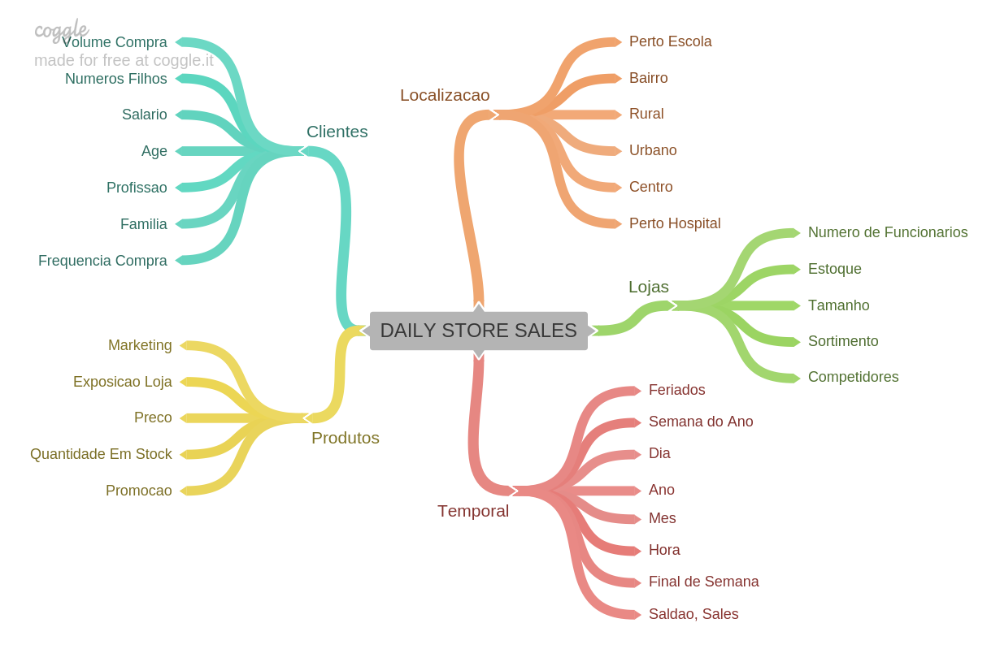

In [23]:
Image('..\img/MindMapHypothesis.png')

## 2.2 Criação as Hipóteses 


### 2.2.1 Hipóteses da Loja
**1)** Lojas com maior número de funcionários deveriam vender mais

**2)** Lojas de maior porte deveriam vender mais

**3)** Lojas de menor porte deveriam vender menos

**4)** Lojas com maior variedade de produtos (sortimento) deveriam vender mais

**5)** Lojas com concorrentes mais proximos deveriam vender menos

**6)** Lojas com maior capacidade de estoque deveriam vender mais 


### 2.2.2. Hipóteses do Produto
1) Lojas que investem mais em marketing deveriam vender mais.

2) Lojas com maior exposição de produto deveriam vender mais.

3) Lojas com preço menor deveriam vender mais.

4) Lojas com promoções mais agressivas (descontos maiores) deveriam vender mais.

5) Lojas com promoções ativas por mais tempo deveriam vender mais.

6) Lojas com mais dias de promocao deveriam vender mais.

7) Lojas com mais promocoes consecutivas deveriam vender mais.

### 2.2.3. Hipoteses Tempo 
1) Lojas que tem mais feriado deveriam vender menos.(fluxo de clientes pode diminuir) 

2) Lojas que abrem nos primeiros 6 meses deveriam vender mais

3) Lojas que abrem nos finais de semana deveriam vender mais

4) Lojas abertas durante o feriado de Natal deveriam vender mais.

5) Lojas deveriam vender mais ao longo dos anos.

6) Lojas deveriam vender mais no segundo semestre do ano.

7) Lojas deveriam vender mais depois do dia 10 de cada mês.

8) Lojas deveriam vender menos durante os feriados escolares.

9) Lojas deveriam vender menos nos finais de semana.

### 2.3 Lista Final de Hipóteses
Tem como objetivo prioriza-las, uma forma de fazer isso é identificar quais dados tenho disponível, por exemplo, lojas com maior número de funcionários deveriam vender mais, nesse primeiro momento não tenho como validar essa hipótese, pois não tenho essa informação disponivel no dataset.

1) Lojas com maior variedades de produtos(sortimento) deveriam vender mais.

2) Lojas com competidores mais próximos deverima vender menos.

3) Lojas com competidores a mais tempo deveriam vender mais.

4) Lojas coom promoções ativas por mais tempo deveriam vender mais.

5) Lojas com mais dias de promoção deveriam vender mais.

6) Lojas com mais promoções consecutivas deveriam vender mais.

7) Lojas abertas durante o feriado de Natala deveriam vender mais.

8) Lojas deveriam vender mais ao longo dos anos.

9) Lojas deveriam vender mais no segundo semestre do ano.

10) Lojas deveriam vender mais depois do dia 10.

11) Lojas deveriam vender menos aos finais de semana.

12) Lojas deveriam vender menos durante os feriados escolares.


## 2.4 Feature Engineering

In [24]:
df2= pd.read_csv("dataset_clean.csv",low_memory=False)
df2["date"] = pd.to_datetime(df2.date)
df2.head(1)

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,promo2,promo2_since_week,promo2_since_year,promo_interval,month_map,is_promo
0,1,5,2015-07-31,5263,555,1,1,0,1,c,a,1270.0,9,2008,0,31,2015,0,Jul,0


In [25]:
# year
df2["year"] = df2["date"].dt.year
# month
df2["month"] = df2["date"].dt.month
# day
df2["day"] = df2["date"].dt.day
# week of year
#df2["year_of_week"] = df2["date"].dt.weekofyear
# year week
df2["year_week"] = df2["date"].dt.week
#df2["year_week"] = df2["date"].dt.strftime("%Y-%W")
# competition since
df2["competition_since"] = df2.apply(lambda x :datetime.datetime(year=x["competition_open_since_year"],month=x["competition_open_since_month"],day=1),axis=1)
df2["competition_time_month"] = ((df2["competition_since"] - df2["date"]) /30) .apply(lambda x: x.days).astype(int)

# promo since
df2['promo_since'] = df2['promo2_since_year'].astype( str ) + '-' + df2['promo2_since_week'].astype( str )
df2['promo_since'] = df2['promo_since'].apply( lambda x: datetime.datetime.strptime( x + '-1', '%Y-%W-%w' ) - datetime.timedelta( days=7 ) )
df2['promo_time_week'] = ( ( df2['date'] - df2['promo_since'] )/7 ).apply( lambda x: x.days ).astype( int )

# assortment a=básico,b=extra,c=estendido
df2["assortment"]= df2["assortment"].apply(lambda x: "basic" if x=="a" else "extra" if x=="b" else "extend")
# state holiday  a = public holiday, b = Easter holiday, c = Christmas, 0 = Nenhum
df2['state_holiday'] = df2['state_holiday'].apply( lambda x: 'public_holiday' if x == 'a' else 'easter_holiday' if x == 'b' else 'christmas' if x == 'c' else 'regular_day' )

In [26]:
df2['date'].dt.isocalendar().week 

0          31
1          31
2          31
3          31
4          31
5          31
6          31
7          31
8          31
9          31
10         31
11         31
12         31
13         31
14         31
15         31
16         31
17         31
18         31
19         31
20         31
21         31
22         31
23         31
24         31
25         31
26         31
27         31
28         31
29         31
30         31
31         31
32         31
33         31
34         31
35         31
36         31
37         31
38         31
39         31
40         31
41         31
42         31
43         31
44         31
45         31
46         31
47         31
48         31
49         31
50         31
51         31
52         31
53         31
54         31
55         31
56         31
57         31
58         31
59         31
60         31
61         31
62         31
63         31
64         31
65         31
66         31
67         31
68         31
69         31
70         31
71    

# 3.0. PASSO 03 - FILTRAGEM DE VARIÁVEIS

A filtragem de variaveis está relacionada a restrição de negócios, ou seja, filtrar dados disponiveis na hora da previsão, por exemplo, não vamos ter a informação do total de clientes na hora da previsão, devemos desconsiderar essa feature.

In [27]:
df3 = df2.copy()

In [28]:
df3.head()

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,promo2,promo2_since_week,promo2_since_year,promo_interval,month_map,is_promo,year,month,day,year_week,competition_since,competition_time_month,promo_since,promo_time_week
0,1,5,2015-07-31,5263,555,1,1,regular_day,1,c,basic,1270.0,9,2008,0,31,2015,0,Jul,0,2015,7,31,31,2008-09-01,-85,2015-07-27,0
1,2,5,2015-07-31,6064,625,1,1,regular_day,1,a,basic,570.0,11,2007,1,13,2010,"Jan,Apr,Jul,Oct",Jul,1,2015,7,31,31,2007-11-01,-95,2010-03-22,279
2,3,5,2015-07-31,8314,821,1,1,regular_day,1,a,basic,14130.0,12,2006,1,14,2011,"Jan,Apr,Jul,Oct",Jul,1,2015,7,31,31,2006-12-01,-106,2011-03-28,226
3,4,5,2015-07-31,13995,1498,1,1,regular_day,1,c,extend,620.0,9,2009,0,31,2015,0,Jul,0,2015,7,31,31,2009-09-01,-72,2015-07-27,0
4,5,5,2015-07-31,4822,559,1,1,regular_day,1,a,basic,29910.0,4,2015,0,31,2015,0,Jul,0,2015,7,31,31,2015-04-01,-5,2015-07-27,0


## 3.1. Filtragem das Linhas

Devemos considerar a feature open como difente de zero assim como sales maior que de zero para previsão.

In [29]:
df3= df3[(df3.open != 0) & (df3.sales > 0)]

## 3.2 Seleção de Colunas

In [30]:
cols_drop = ["customers","open","promo_interval","month_map"]
df3 = df3.drop(cols_drop,axis=1)

# 4.0. PASSO 04 - ANALISE EXPLORATORIA DOS DADOS

### Objetivos
1) Ganhar experiência de negócio.

2) Validar as hipoteses de negócio (Insights).

3) Seleção de variaveis importante para o modelo.




In [31]:
df4 = df3.copy()

## 4.1 Análise Univariada

### 4.1.1. Response Variable

<AxesSubplot: xlabel='sales'>

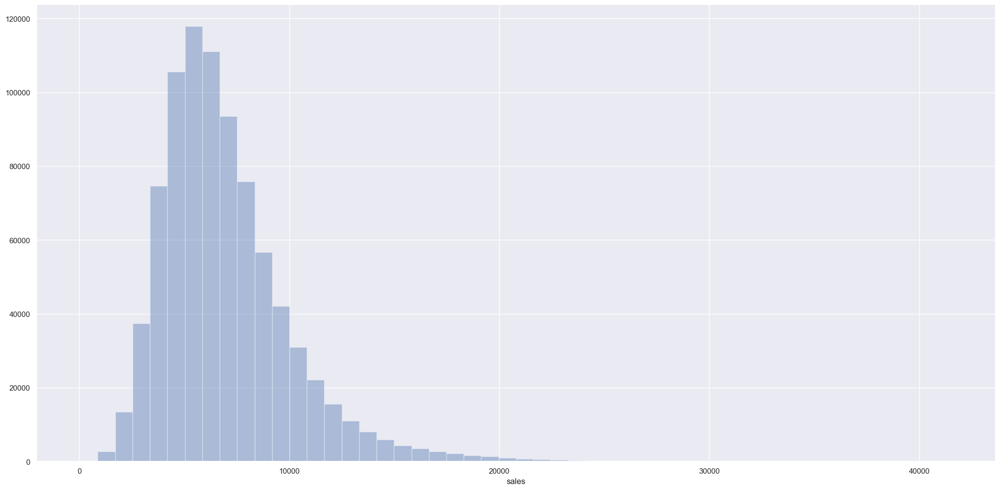

In [32]:
sns.distplot( df4['sales'], kde=False  )

<AxesSubplot: xlabel='sales', ylabel='Density'>

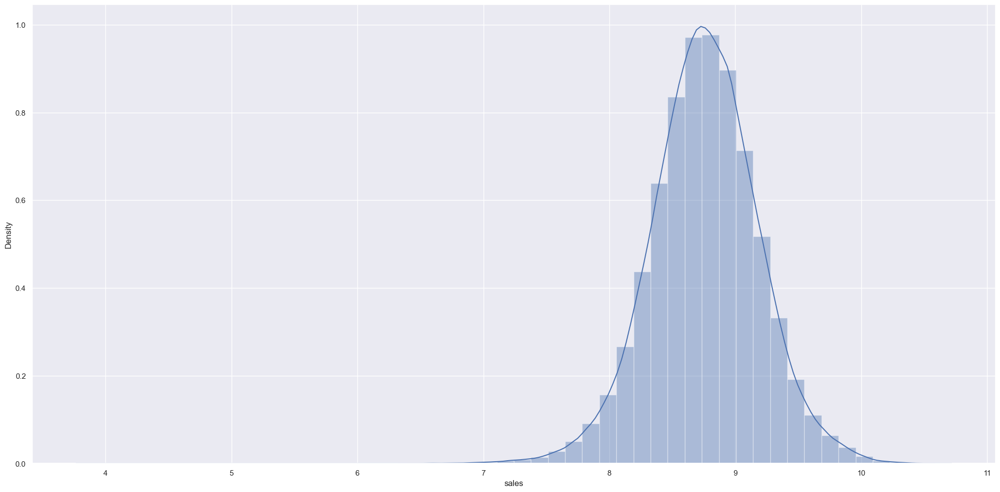

In [33]:
sns.distplot( np.log1p(df4["sales"]) )

### 4.1.2. Numerical Variable

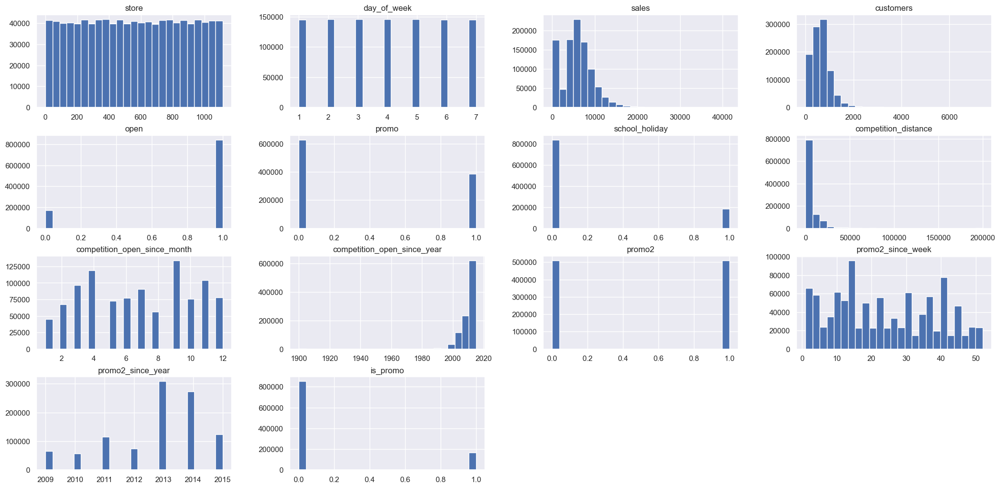

In [34]:
num_attributes.hist( bins=25 );

### 4.1.3. Categorical Variable

In [35]:
# # state_holiday
# plt.subplot( 3, 2, 1 )
# a = df4[df4['state_holiday'] != 'regular_day']
# sns.countplot( a['state_holiday'] )

# plt.subplot( 3, 2, 2 )
# sns.kdeplot( df4[df4['state_holiday'] == 'public_holiday']['sales'], label='public_holiday', shade=True )
# sns.kdeplot( df4[df4['state_holiday'] == 'easter_holiday']['sales'], label='easter_holiday', shade=True )
# sns.kdeplot( df4[df4['state_holiday'] == 'christmas']['sales'], label='christmas', shade=True )

# # store_type
# plt.subplot( 3, 2, 3 )
# sns.countplot( df4['store_type'] )

# plt.subplot( 3, 2, 4 )
# sns.kdeplot( df4[df4['store_type'] == 'a']['sales'], label='a', shade=True )
# sns.kdeplot( df4[df4['store_type'] == 'b']['sales'], label='b', shade=True )
# sns.kdeplot( df4[df4['store_type'] == 'c']['sales'], label='c', shade=True )
# sns.kdeplot( df4[df4['store_type'] == 'd']['sales'], label='d', shade=True )

# # assortment
# plt.subplot( 3, 2, 5 )
# sns.countplot( df4['assortment'] )

# plt.subplot( 3, 2, 6 )
# sns.kdeplot( df4[df4['assortment'] == 'extended']['sales'], label='extended', shade=True )
# sns.kdeplot( df4[df4['assortment'] == 'basic']['sales'], label='basic', shade=True )
# sns.kdeplot( df4[df4['assortment'] == 'extra']['sales'], label='extra', shade=True )

In [36]:
#create_report(df4)

## 4.2. Analise Bivariada

### H1. Lojas com maior variedades de produtos(sortimento) deveriam vender mais.
Está hipótese é FALSA,pois como mostra os dados lojas com maior sortimento vendem menos

In [37]:
df4.head(1)

,store,day_of_week,date,sales,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,promo2,promo2_since_week,promo2_since_year,is_promo,year,month,day,year_week,competition_since,competition_time_month,promo_since,promo_time_week
0,1,5,2015-07-31,5263,1,regular_day,1,c,basic,1270.0,9,2008,0,31,2015,0,2015,7,31,31,2008-09-01,-85,2015-07-27,0


<AxesSubplot: xlabel='year_week'>

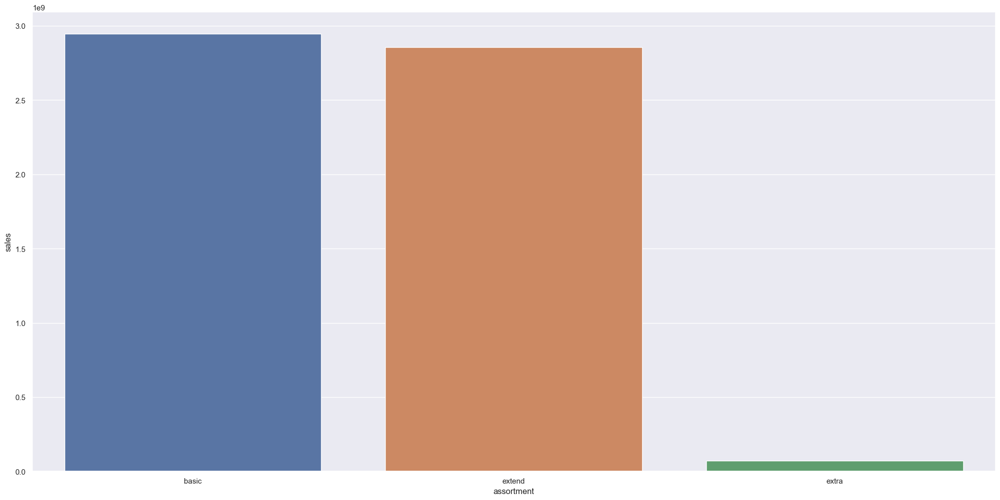

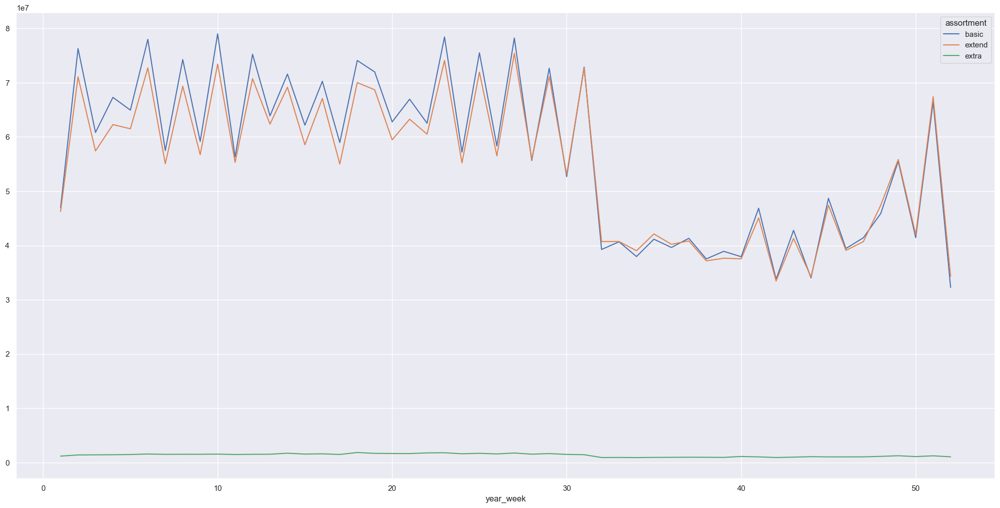

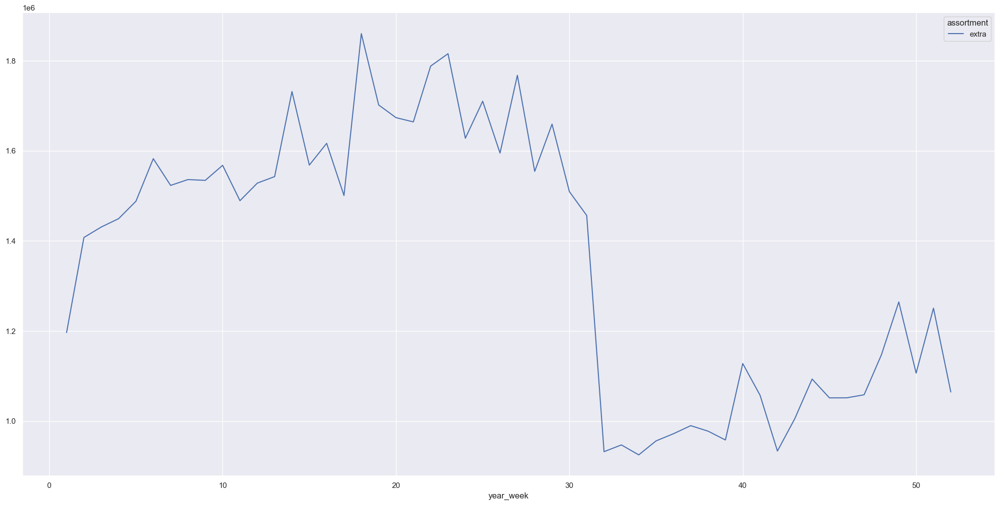

In [38]:
aux1 = df4[["sales","assortment"]].groupby("assortment").sum().reset_index()
sns.barplot(x="assortment",y="sales",data=aux1)

aux2 = df4[["year_week","sales","assortment"]].groupby(["year_week","assortment"]).sum().reset_index()
aux2.pivot(index="year_week",columns="assortment",values="sales").plot()

aux3 = aux2[aux2["assortment"]=="extra"]
aux3.pivot(index="year_week",columns="assortment",values="sales").plot() 

### H2. Lojas com competidores mais próximos deveriam vender menos
Está hipotese é **FALSA**, pois quanto mais proximo está o concorrente maior é a **VENDAS**

In [39]:
bins = list(np.arange(0,20000,1000))


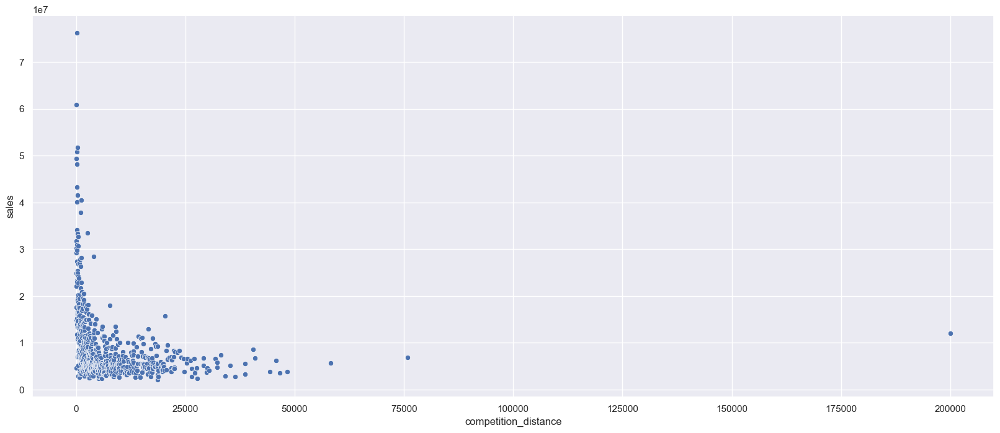

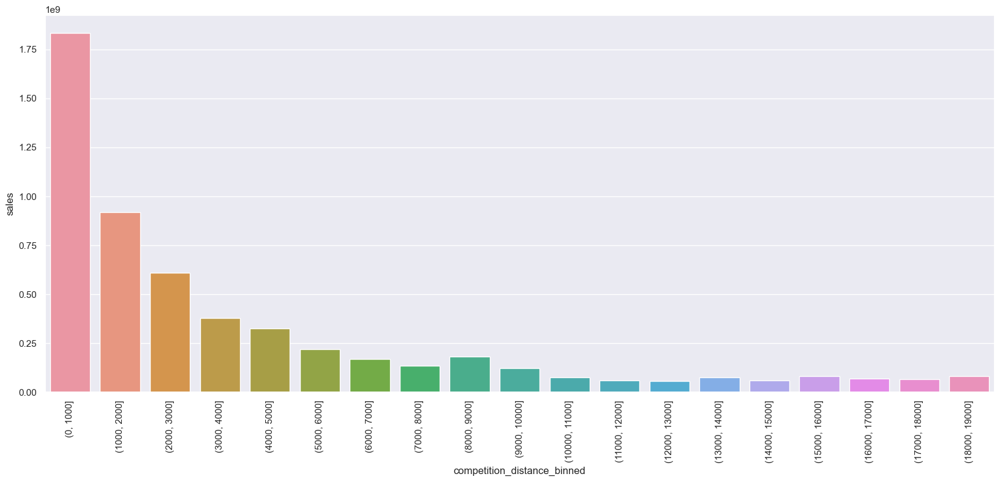

In [40]:
# competition_distance
aux1 = df4[["sales","competition_distance"]].groupby(["competition_distance"]).sum().reset_index()
#plt.subplot(1,3,1)
plt.figure(figsize=(20,8))
sns.scatterplot(x="competition_distance",y="sales",data=aux1)
#plt.show()

#plt.subplot(1,3,2)
bins = list(np.arange(0,20000,1000))
aux1["competition_distance_binned"]= pd.cut(aux1["competition_distance"],bins=bins)
aux2 = aux1[["sales","competition_distance_binned"]].groupby(["competition_distance_binned"]).sum().reset_index()
plt.figure(figsize=(20,8))
sns.barplot(x="competition_distance_binned",y="sales",data=aux2)
plt.xticks(rotation=90);



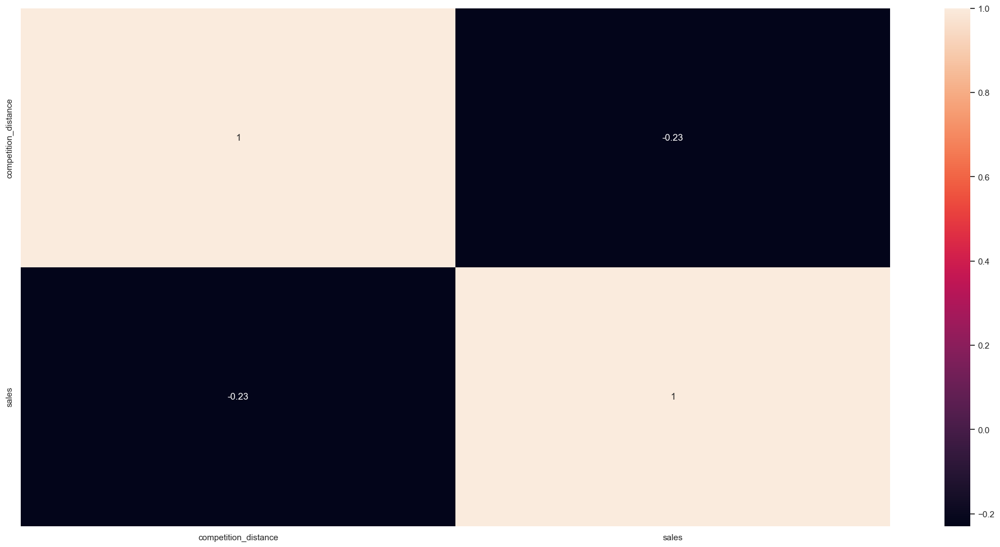

In [41]:
sns.heatmap(aux1.corr(),annot=True);

### H3. Lojas com competidores a mais tempo deveriam vender mais.
Está hipótese é **FALSA**, pois quanto maior tempo que a loja concorrente está aberto menor é as vendas

In [42]:
df4[["date","competition_since","competition_time_month"]].sample()

,date,competition_since,competition_time_month
326769,2014-09-26,2008-06-01,-77


<AxesSubplot: xlabel='competition_time_month', ylabel='sales'>

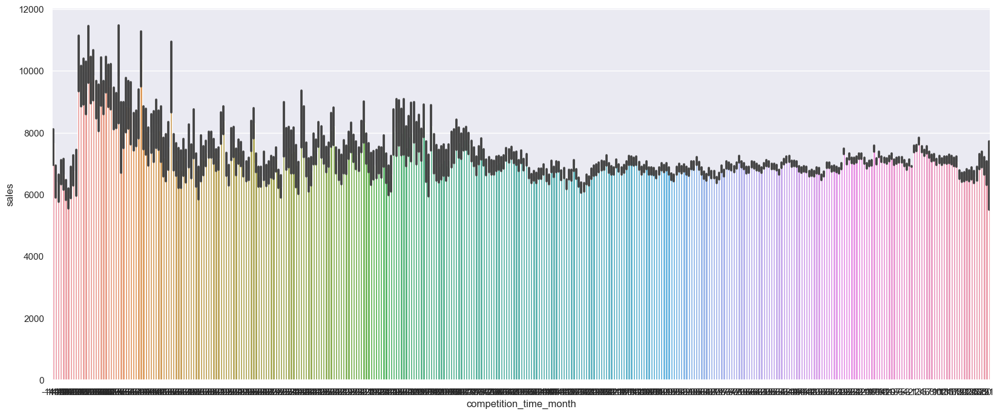

In [43]:
aux1 = df4[["sales","competition_time_month"]].groupby("competition_time_month").sum().reset_index()
aux2 = df4[(df4["competition_time_month"] < 120) & (df4["competition_time_month"]!=0)]

plt.figure(figsize=(20,8))
sns.barplot(x="competition_time_month",y="sales",data=aux2)

In [44]:
df4.loc[df4["competition_time_month"] ==0,["date","competition_since","competition_time_month"]].head(2)
#df4[["date","competition_since","competition_time_month"]].sample()

,date,competition_since,competition_time_month
687,2015-07-31,2015-08-01,0
1019,2015-07-31,2015-08-01,0


<AxesSubplot: >

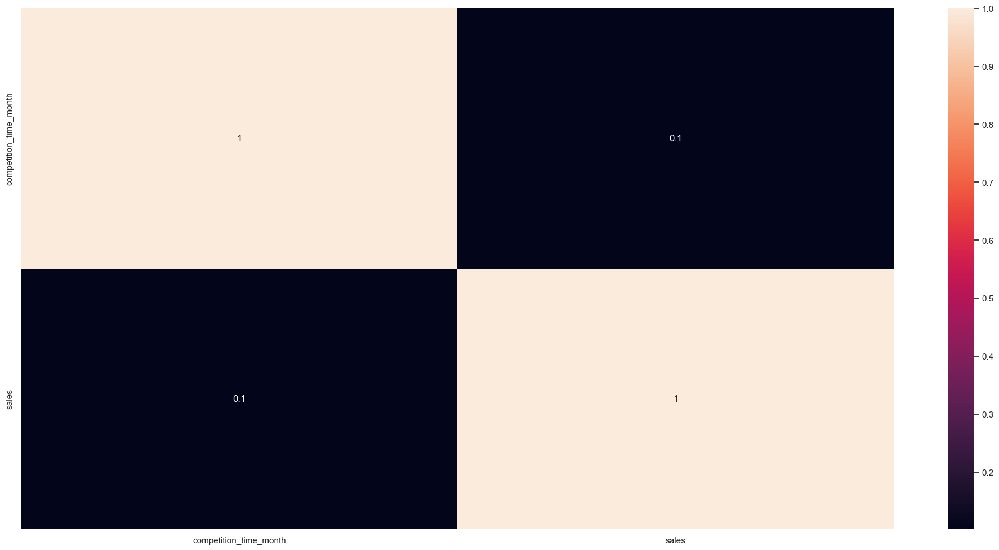

In [45]:
sns.heatmap(aux1.corr(method="pearson"),annot=True) 

## H4. Lojas com promoções ativas por mais tempo deveriam vender mais.

Está hipótese é **FALSA**,como mostra o primeiro grafico lojas com promoções ativas por mais tempo vendem menos,depois de um certo periodo de promocao. Descontinuar as promoções extendidas ativas ao atingirem no máximo 220 semanas, mantendo apenas promoções pontuais, ou realizando novas campanhas promocionais.

<AxesSubplot: >

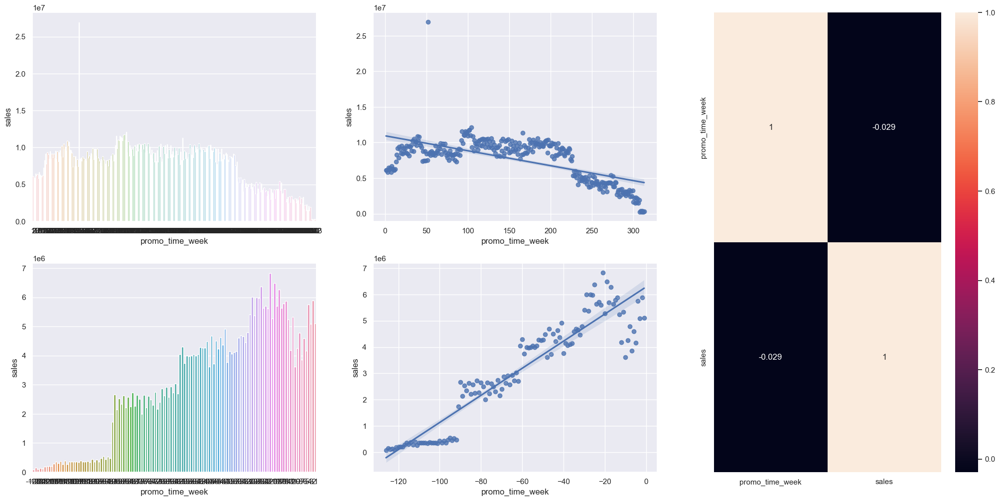

In [46]:
aux1 = df4[["sales","promo_time_week"]].groupby("promo_time_week").sum().reset_index()
aux2 = aux1[aux1["promo_time_week"] > 0] # promo extendida
aux3 = aux1[aux1["promo_time_week"] < 0] # promo regular

grid = GridSpec(2,3)
plt.subplot(grid[0,0])
sns.barplot(x="promo_time_week",y="sales",data=aux2)

plt.subplot(grid[0,1])
sns.regplot(x="promo_time_week",y="sales",data=aux2)

plt.subplot(grid[1,0])
sns.barplot(x="promo_time_week",y="sales",data=aux3)

plt.subplot(grid[1,1])
sns.regplot(x="promo_time_week",y="sales",data=aux3)

plt.subplot(grid[:,2])
sns.heatmap(aux1.corr(method="pearson"),annot=True)

## H5. Lojas com mais dias de promoção deveriam vender mais.

## H6. Lojas com mais promoções consecutivas deveriam vender mais.

In [47]:
#df4[["promo","promo2","year_week"]].head(2)
df4[["sales","promo","promo2"]].groupby(["promo","promo2"]).sum().reset_index()

,promo,promo2,sales
0,0,0,1482612096
1,0,1,1289362241
2,1,0,1628930532
3,1,1,1472275754


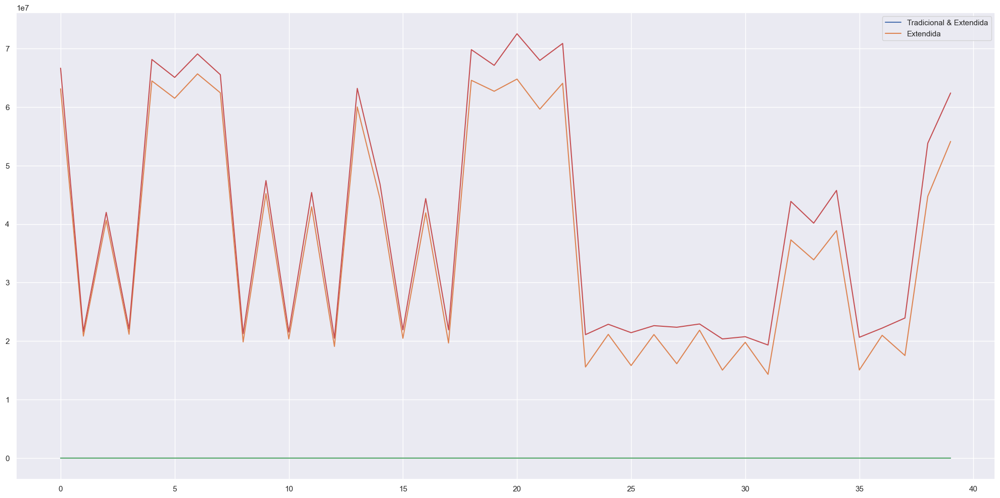

In [75]:
promo_regular = df4[(df4["promo"]==1) & (df4["promo2"] ==1)][["sales","year_week"]].groupby(["year_week"]).sum().reset_index()
ax=promo_regular.plot()

promo_extendida = df4[(df4["promo"]==1) & (df4["promo2"] ==0)][["sales","year_week"]].groupby(["year_week"]).sum().reset_index()
promo_extendida.plot(ax=ax)

ax.legend(labels=['Tradicional & Extendida', 'Extendida'])

### H7. Lojas abertas durante o feriado de Natal deveriam vender mais.



In [50]:
#df4.columns 
df4["state_holiday"].unique()

array(['regular_day', 'public_holiday', 'easter_holiday', 'christmas'],
      dtype=object)

###  H8. Lojas deveriam vender mais ao longo dos anos.
**FALSA**, Lojas vendem menos ao longo dos anos.



<AxesSubplot: xlabel='year', ylabel='sales'>

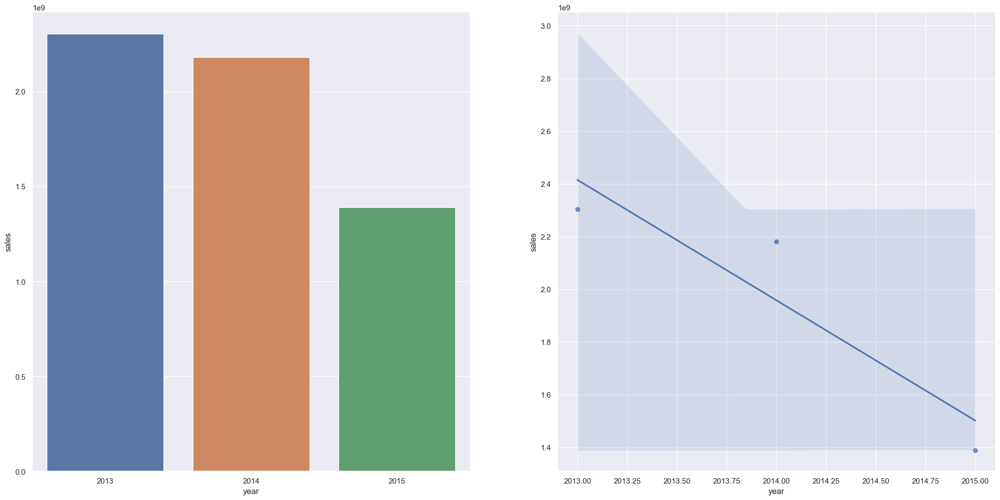

In [51]:
sales_per_year = df4[["sales","year"]].groupby("year").sum().reset_index()

plt.subplot(1,2,1)
sns.barplot(x="year",y="sales",data=sales_per_year)
plt.subplot(1,2,2)
sns.regplot(x="year",y="sales",data=sales_per_year)

### H9. Lojas deveriam vender mais no segundo semestre do ano.
**FALSA**, Lojas vendem menos a partir do segundo semestre do ano.

<AxesSubplot: xlabel='month', ylabel='sales'>

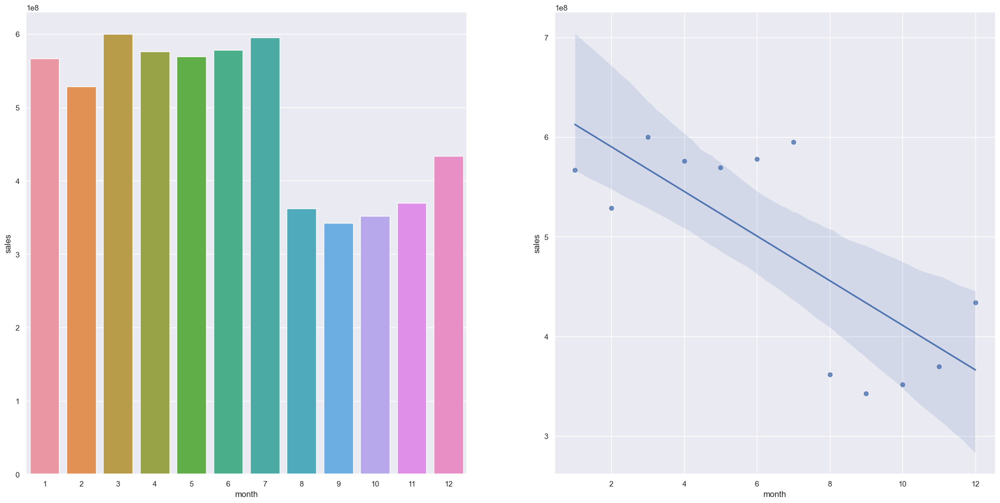

In [52]:
sales_per_month = df4[["sales","month"]].groupby("month").sum().reset_index()

plt.subplot(1,2,1)
sns.barplot(x="month",y="sales",data=sales_per_month)
plt.subplot(1,2,2)
sns.regplot(x="month",y="sales",data=sales_per_month)

### H10. Lojas deveriam vender mais depois do dia 10
**VERDADEIRA**, Lojas vendem mais depois do dia 10

<AxesSubplot: xlabel='before_after', ylabel='sales'>

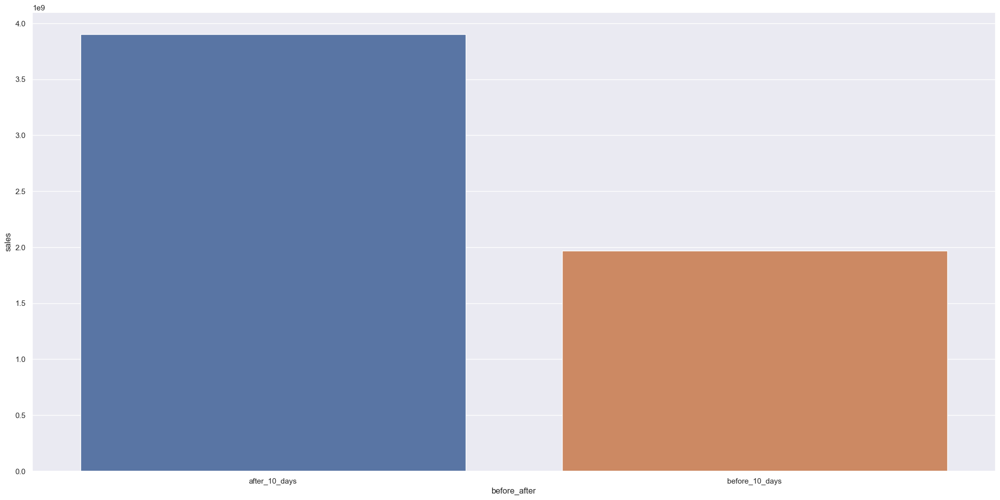

In [53]:
sales_per_day = df4[["sales","day"]].groupby("day").sum().reset_index()
sales_per_day["before_after"] = sales_per_day["day"].apply(lambda x:"before_10_days" if x <=10 else "after_10_days")
sales_before_after_10 = sales_per_day[["sales","before_after"]].groupby("before_after").sum().reset_index()
sns.barplot(x="before_after",y="sales",data=sales_before_after_10)

<AxesSubplot: >

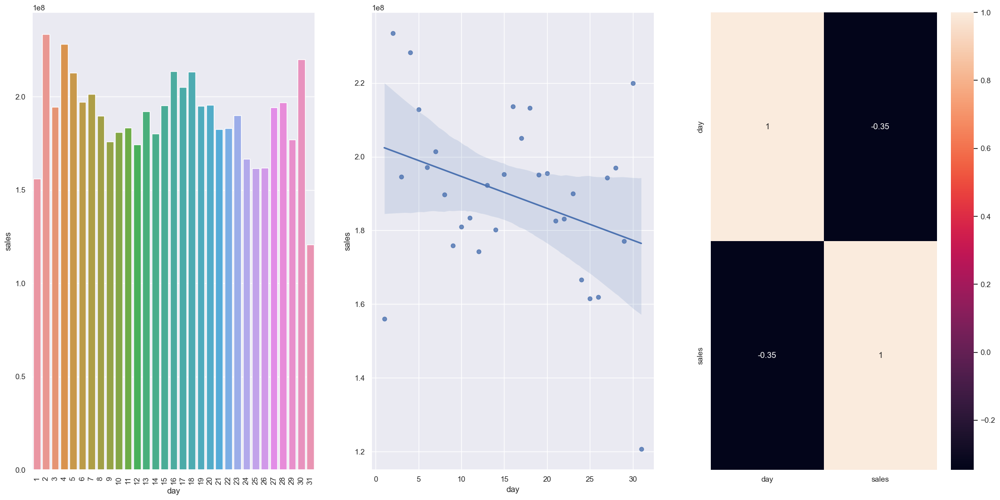

In [54]:
sales_per_day = df4[["sales","day"]].groupby("day").sum().reset_index()

plt.subplot(1,3,1)
sns.barplot(x="day",y="sales",data=sales_per_day)
plt.xticks(rotation=90)

plt.subplot(1,3,2)
sns.regplot(x="day",y="sales",data=sales_per_day)

plt.subplot(1,3,3)
sns.heatmap(sales_per_day.corr(method="pearson"),annot=True)



### H11. Lojas deveriam vender menos aos finais de semana
**VERDADEIRA**, Lojas vendem menos aos finais de semana

<AxesSubplot: >

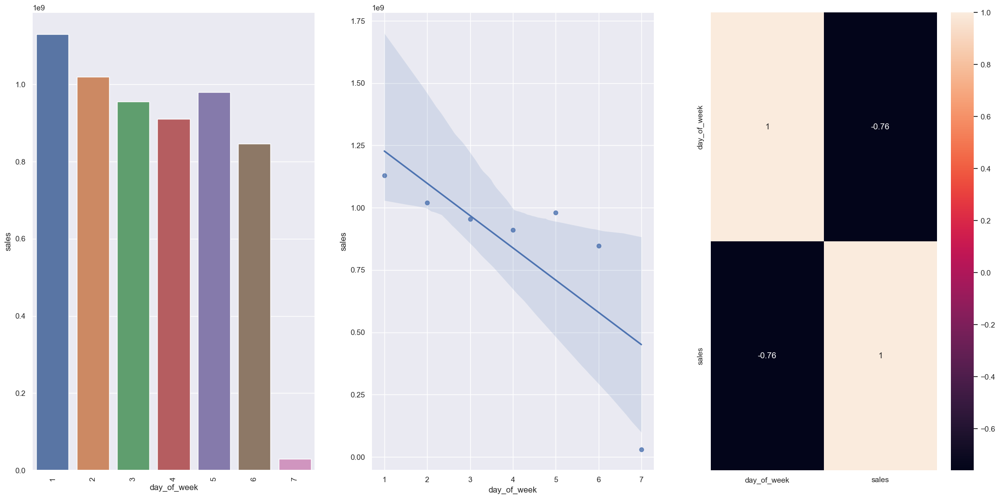

In [55]:
sales_per_day_of_week = df4[["sales","day_of_week"]].groupby("day_of_week").sum().reset_index()

plt.subplot(1,3,1)
sns.barplot(x="day_of_week",y="sales",data=sales_per_day_of_week)
plt.xticks(rotation=90)

plt.subplot(1,3,2)
sns.regplot(x="day_of_week",y="sales",data=sales_per_day_of_week)

plt.subplot(1,3,3)
sns.heatmap(sales_per_day_of_week.corr(method="pearson"),annot=True)

### H12. Lojas deveriam vender menos durante os feriados escolares.
**VERDADEIRA**, Lojas vendem menos durantes os feriados escolares exceto no meses de julho e agosto. Considerar um maior aproveitamento deste aumento de vendas nos feriados escolares desse período elaborando promoções focadas em clientes nas faixas etárias escolares.

<AxesSubplot: >

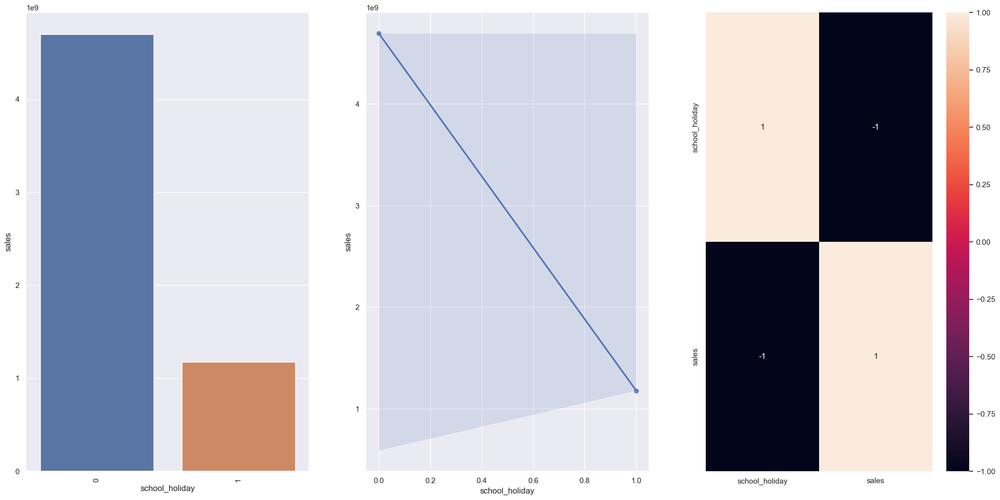

In [56]:
sales_per_school_holiday = df4[["sales","school_holiday"]].groupby("school_holiday").sum().reset_index()

plt.subplot(1,3,1)
sns.barplot(x="school_holiday",y="sales",data=sales_per_school_holiday)
plt.xticks(rotation=90)

plt.subplot(1,3,2)
sns.regplot(x="school_holiday",y="sales",data=sales_per_school_holiday)

plt.subplot(1,3,3)
sns.heatmap(sales_per_school_holiday.corr(method="pearson"),annot=True)

<AxesSubplot: xlabel='month', ylabel='sales'>

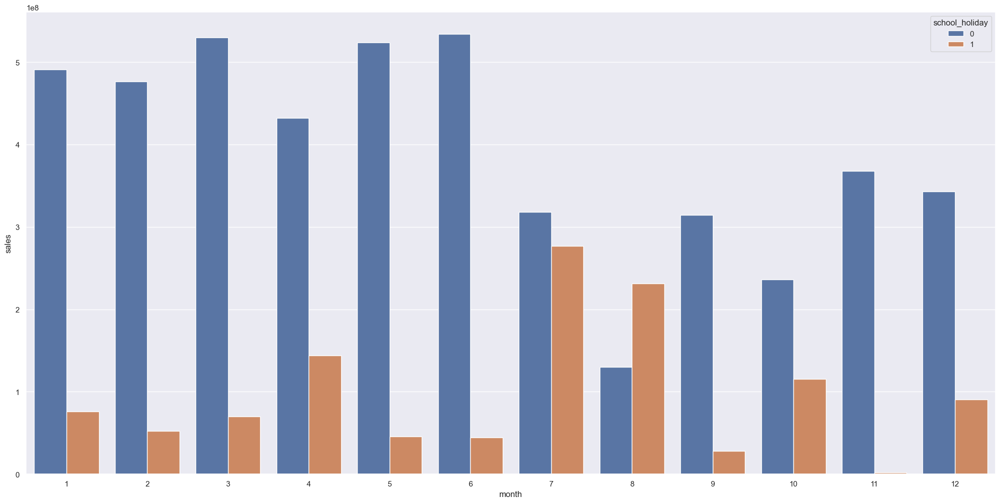

In [57]:
sales_per_school_holiday_month = df4[["sales","month","school_holiday"]].groupby(["month","school_holiday"]).sum().reset_index()
sns.barplot(x="month",y="sales",hue="school_holiday",data=sales_per_school_holiday_month)

### 4.2.1. Resumo das Hipoteses

In [58]:
!pip install tabulate

In [59]:
from tabulate import tabulate

In [60]:
tab =[['Hipoteses', 'Conclusao', 'Relevancia'],
      ['H1', 'Falsa', 'Baixa'],  
      ['H2', 'Falsa', 'Media'],  
      ['H3', 'Falsa', 'Media'],
      ['H4', 'Falsa', 'Baixa'],
      ['H5', '-', '-'],
      ['H7', 'Falsa', 'Baixa'],
      ['H8', 'Falsa', 'Media'],
      ['H9', 'Falsa', 'Alta'],
      ['H10', 'Falsa', 'Alta'],
      ['H11', 'Verdadeira', 'Alta'],
      ['H12', 'Verdadeira', 'Alta'],
      ['H13', 'Verdadeira', 'Baixa'],
     ]  
print( tabulate( tab, headers='firstrow' ) )

Hipoteses    Conclusao    Relevancia
-----------  -----------  ------------
H1           Falsa        Baixa
H2           Falsa        Media
H3           Falsa        Media
H4           Falsa        Baixa
H5           -            -
H7           Falsa        Baixa
H8           Falsa        Media
H9           Falsa        Alta
H10          Falsa        Alta
H11          Verdadeira   Alta
H12          Verdadeira   Alta
H13          Verdadeira   Baixa


## 4.3. Analise Multivariada

### 4.3.1. Numerical Attributes

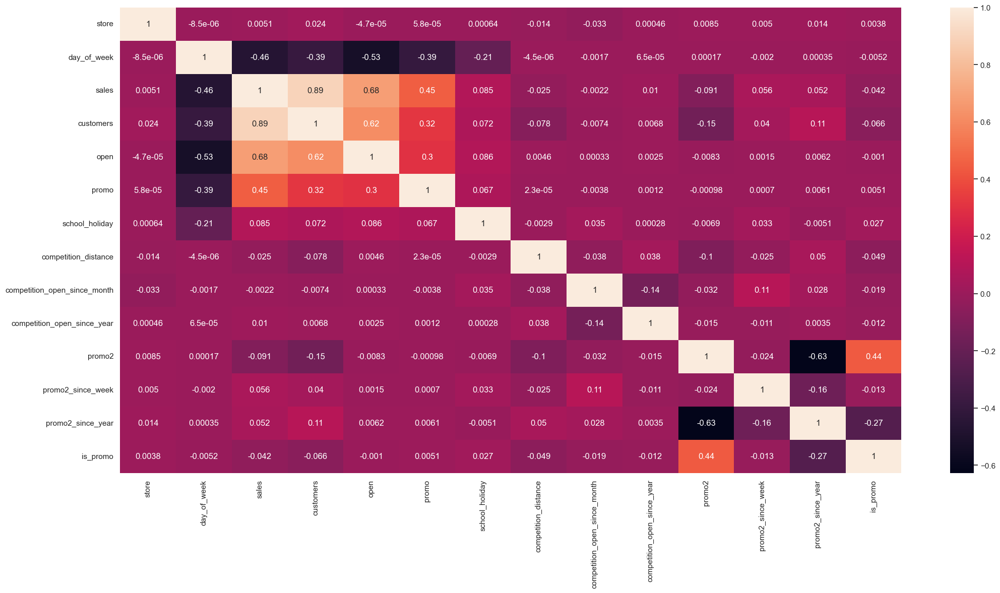

In [61]:
correlation = num_attributes.corr( method='pearson' )
sns.heatmap( correlation, annot=True );

### 4.3.2. Categorical Attributes

<AxesSubplot: >

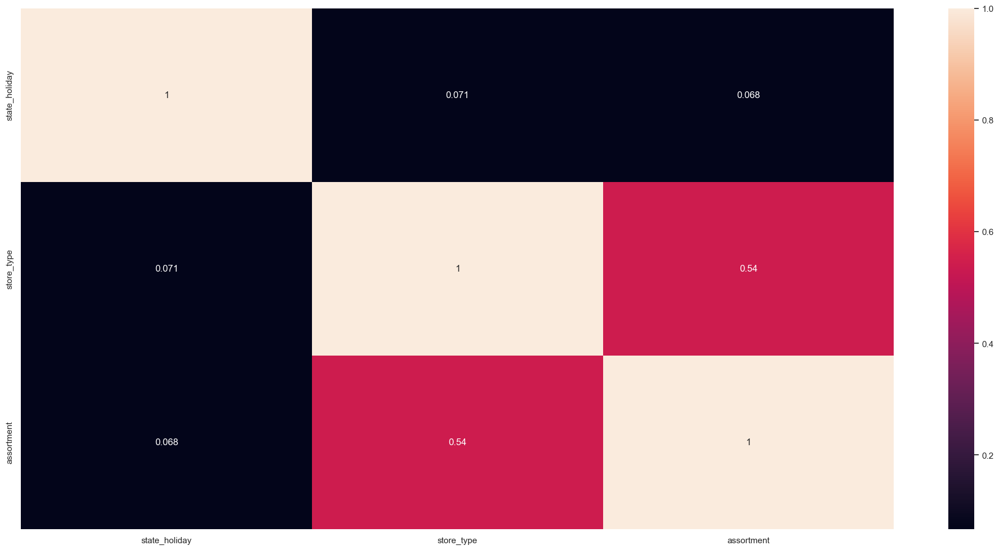

In [62]:
# only categorical data
a = df4.select_dtypes( include='object' )

# Calculate cramer V
a1 = cramer_v( a['state_holiday'], a['state_holiday'] )
a2 = cramer_v( a['state_holiday'], a['store_type'] )
a3 = cramer_v( a['state_holiday'], a['assortment'] )

a4 = cramer_v( a['store_type'], a['state_holiday'] )
a5 = cramer_v( a['store_type'], a['store_type'] )
a6 = cramer_v( a['store_type'], a['assortment'] )

a7 = cramer_v( a['assortment'], a['state_holiday'] )
a8 = cramer_v( a['assortment'], a['store_type'] )
a9 = cramer_v( a['assortment'], a['assortment'] )

# Final dataset
d = pd.DataFrame( {'state_holiday': [a1, a2, a3], 
               'store_type': [a4, a5, a6],
               'assortment': [a7, a8, a9]  })
d = d.set_index( d.columns )

sns.heatmap( d, annot=True )

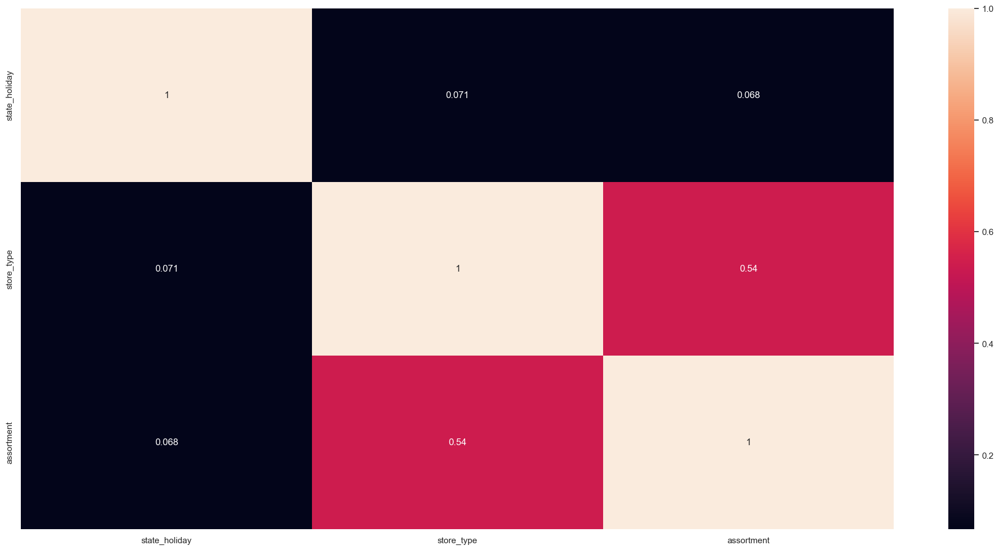

In [63]:
cat = df4.select_dtypes(include=['object'])

cat_list = ['state_holiday', 'store_type', 'assortment']
cat_dic = {}

for c1 in cat_list:
    for c2 in cat_list:
        v = cramer_v(cat[c1], cat[c2])
        if cat_list.index(c2) == 0:
            cat_dic[c1] = []
            cat_dic[c1].append(v)
        else:
            cat_dic[c1].append(v)

cramer_v_table = pd.DataFrame(cat_dic)
cramer_v_table.set_index(cramer_v_table.columns, inplace=True)
sns.heatmap(cramer_v_table, annot=True);

# 5.0. PASSO 05 - DATA PREPARATION

In [64]:
df5 = df4.copy()

<AxesSubplot: >

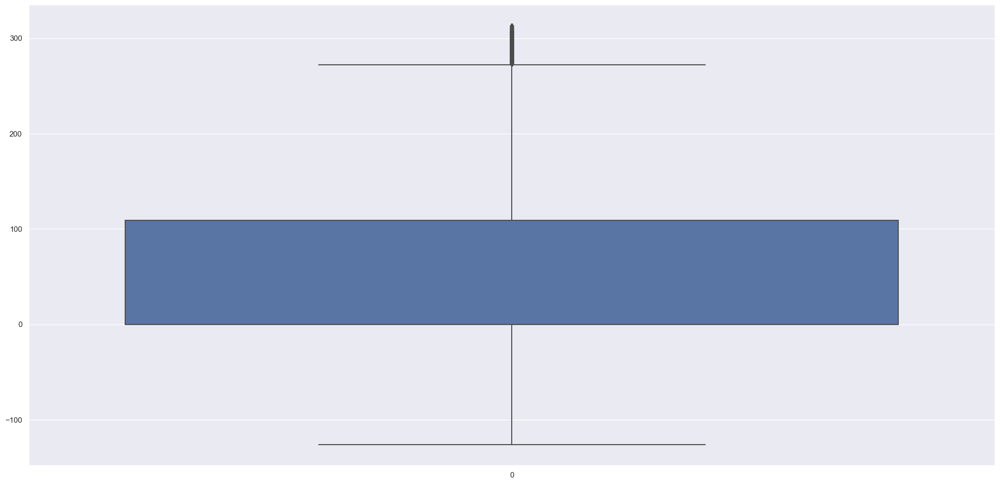

In [65]:
#px.box(df5["competition_distance"])
sns.boxplot(df5["promo_time_week"])

## 5.1 Normalização 
Deve-se ser utilizada para variaveis que tem uma distribuicação normal

## 5.2 Rescaling 
1) Utiliza-se o MinMaxScaler para variaveis que não tenham ouliers

2) Utiliza-se o RobustScaler para variaveis que tenham outliers

In [66]:
# competition_distance
rs = RobustScaler()
df5["competition_distance"]= rs.fit_transform(df5["competition_distance"].values.reshape(-1, 1))
pickle.dump(rs, open(r"C:\Users\Douglas\Documents\repos\datascience_em_producao\parameter\competition_distance_scaler.pkl","wb"))
# competition_time_month
df5["competition_time_month"] = rs.fit_transform(df5["competition_time_month"].values.reshape(-1,1))
pickle.dump(rs, open(r"C:\Users\Douglas\Documents\repos\datascience_em_producao\parameter\competition_time_month_scaler.pkl","wb"))
# promo_time_week
mms = MinMaxScaler()
df5["promo_time_week"] = mms.fit_transform(df5["promo_time_week"].values.reshape(-1,1))
pickle.dump(mms, open(r"C:\Users\Douglas\Documents\repos\datascience_em_producao\parameter\promo_time_week_scaler.pkl","wb"))
df5["year"] = mms.fit_transform(df5[["year"]].values)
pickle.dump(mms,open(r"C:\Users\Douglas\Documents\repos\datascience_em_producao\parameter\year_scaler.pkl","wb"))

# 5.3. Transformacao

## 5.3.1. Enconding

1) One Hot Encoding = deve-se ser usado quando a variavel categórica representa mudança de estado, por exemplo, a variavel
state_holiday apresenta um comportamento de vendas em dias normais e outro em dias de feriados, isso indica uma mudança de estado e também é viavel usar quando não temos muitos níveis, ou seja, até 6 níveis.


In [67]:
df5.select_dtypes(include="object").head(2)

,state_holiday,store_type,assortment
0,regular_day,c,basic
1,regular_day,a,basic


In [68]:
# state_holiday - One Hot Encoding
df5 = pd.get_dummies( df5, prefix=['state_holiday'], columns=['state_holiday'] )

# store_type - Label Encoding
le = LabelEncoder()
df5["store_type"] = le.fit_transform(df5["store_type"])
pickle.dump(le,open(r"C:\Users\Douglas\Documents\repos\datascience_em_producao\parameter\store_type_scaler.pkl","wb"))
# assortment - Ordinal Encoding
dic = {"basic":1,"extra":2,"extend":3}
df5["assortment"] = df5["assortment"].map(dic)


## Transformações de natureza:
***O objetivo é trazer a natureza real do seus dados dentro de conjunto de dados***
## Transformações de grandeza:
***O objetivo é trazer a variavel resposta o mais próximo possível de uma distribuição normal***

## 5.3.2. Response Variable Transformation 



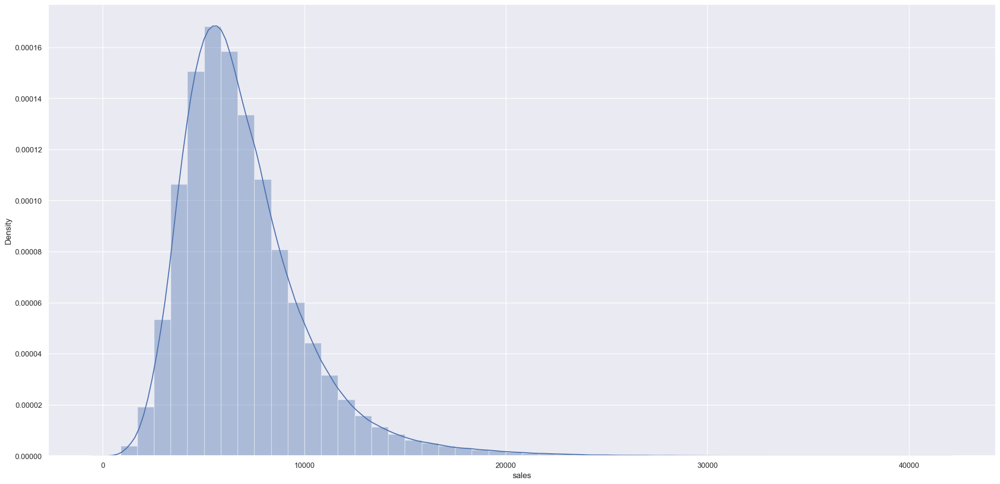

In [69]:
sns.distplot(df5["sales"]);

In [70]:
df5["sales"] = np.log1p(df5["sales"])

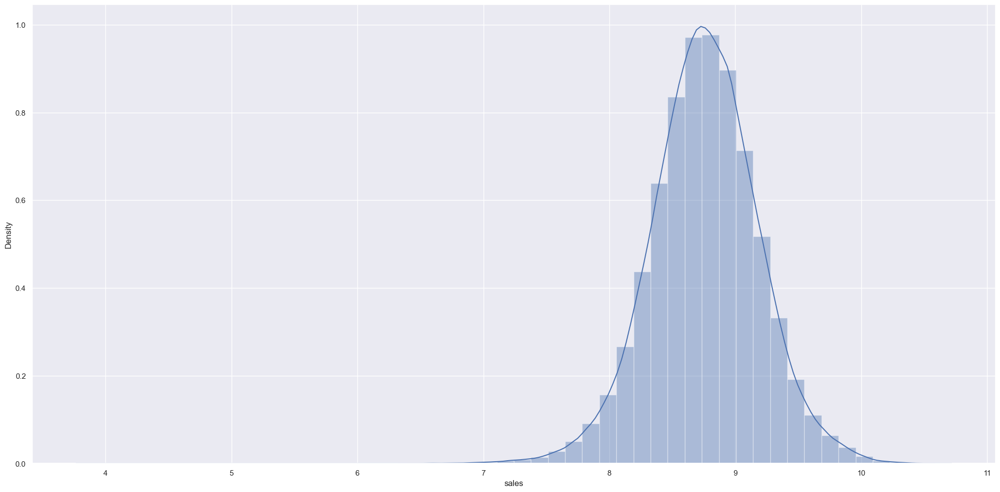

In [71]:
sns.distplot(df5["sales"]);

### 5.3.3. Nature Transformation 

In [76]:
#day_of_week
df5["day_of_week_cos"] = df5["day_of_week"].apply(lambda x: np.cos( x * (2. * np.pi/7 )))
df5["day_of_week_sin"] = df5["day_of_week"].apply(lambda x: np.sin( x *  (2. * np.pi/7)))                                                  
#month
df5["month_cos"] = df5["month"].apply(lambda x: np.cos( x * (2. * np.pi/12)))
df5["month_sin"] = df5["month"].apply(lambda x: np.sin( x * (2. * np.pi/12)))                                                   
#day
df5["day_cos"] = df5["day"].apply(lambda x: np.cos( x * (2. * np.pi/30 )))
df5["day_sin"] = df5["day"].apply(lambda x: np.sin( x * (2. * np.pi/30 )))                                      
#year_of_week
df5["year_of_week_cos"] = df5["year_week"].apply(lambda x: np.cos( x * (2. * np.pi/52)))
df5["year_of_week_sin"] = df5["year_week"].apply(lambda x: np.sin( x * (2. * np.pi/52))) 
                                  

In [77]:
df5.head(2)

,store,day_of_week,date,sales,promo,school_holiday,store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,promo2,promo2_since_week,promo2_since_year,is_promo,year,month,day,year_week,competition_since,competition_time_month,promo_since,promo_time_week,state_holiday_christmas,state_holiday_easter_holiday,state_holiday_public_holiday,state_holiday_regular_day,day_of_week_cos,day_of_week_sin,month_cos,month_sin,day_cos,day_sin,year_of_week_cos,year_of_week_sin
0,1,5,2015-07-31,8.568646,1,1,2,1,-0.170968,9,2008,0,31,2015,0,1.0,7,31,31,2008-09-01,-0.918919,2015-07-27,0.287016,0,0,0,1,-0.222521,-0.974928,-0.866025,-0.5,0.978148,0.207912,-0.822984,-0.568065
1,2,5,2015-07-31,8.710290,1,1,0,1,-0.283871,11,2007,1,13,2010,1,1.0,7,31,31,2007-11-01,-1.054054,2010-03-22,0.922551,0,0,0,1,-0.222521,-0.974928,-0.866025,-0.5,0.978148,0.207912,-0.822984,-0.568065


# 6.0. PASSO 06 - FEATURE SELECTION Feature Selection

In [78]:
df6= df5.copy()
#df6 = pd.read_csv("df5.csv") 

In [79]:
df6.columns

Index(['store', 'day_of_week', 'date', 'sales', 'promo', 'school_holiday',
       'store_type', 'assortment', 'competition_distance',
       'competition_open_since_month', 'competition_open_since_year', 'promo2',
       'promo2_since_week', 'promo2_since_year', 'is_promo', 'year', 'month',
       'day', 'year_week', 'competition_since', 'competition_time_month',
       'promo_since', 'promo_time_week', 'state_holiday_christmas',
       'state_holiday_easter_holiday', 'state_holiday_public_holiday',
       'state_holiday_regular_day', 'day_of_week_cos', 'day_of_week_sin',
       'month_cos', 'month_sin', 'day_cos', 'day_sin', 'year_of_week_cos',
       'year_of_week_sin'],
      dtype='object')

### 6.1 Split dataframe into training and test dataset

In [81]:
cols_drop = ["day_of_week","month","day","competition_since","year_week"]
df6 = df6.drop(columns=cols_drop,axis=1)

In [82]:
df6.head()

,store,date,sales,promo,school_holiday,store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,promo2,promo2_since_week,promo2_since_year,is_promo,year,competition_time_month,promo_since,promo_time_week,state_holiday_christmas,state_holiday_easter_holiday,state_holiday_public_holiday,state_holiday_regular_day,day_of_week_cos,day_of_week_sin,month_cos,month_sin,day_cos,day_sin,year_of_week_cos,year_of_week_sin
0,1,2015-07-31,8.568646,1,1,2,1,-0.170968,9,2008,0,31,2015,0,1.0,-0.918919,2015-07-27,0.287016,0,0,0,1,-0.222521,-0.974928,-0.866025,-0.5,0.978148,0.207912,-0.822984,-0.568065
1,2,2015-07-31,8.710290,1,1,0,1,-0.283871,11,2007,1,13,2010,1,1.0,-1.054054,2010-03-22,0.922551,0,0,0,1,-0.222521,-0.974928,-0.866025,-0.5,0.978148,0.207912,-0.822984,-0.568065
2,3,2015-07-31,9.025816,1,1,0,1,1.903226,12,2006,1,14,2011,1,1.0,-1.202703,2011-03-28,0.801822,0,0,0,1,-0.222521,-0.974928,-0.866025,-0.5,0.978148,0.207912,-0.822984,-0.568065
3,4,2015-07-31,9.546527,1,1,2,3,-0.275806,9,2009,0,31,2015,0,1.0,-0.743243,2015-07-27,0.287016,0,0,0,1,-0.222521,-0.974928,-0.866025,-0.5,0.978148,0.207912,-0.822984,-0.568065
4,5,2015-07-31,8.481151,1,1,0,1,4.448387,4,2015,0,31,2015,0,1.0,0.162162,2015-07-27,0.287016,0,0,0,1,-0.222521,-0.974928,-0.866025,-0.5,0.978148,0.207912,-0.822984,-0.568065


In [83]:
# training teste
x_train = df6[df6["date"] < '2015-06-19']
y_train = x_train["sales"]

# Test dataset
x_test = df6[df6["date"] >= '2015-06-19']
y_test = x_test["sales"]

print("Training Min Date {}".format(x_train["date"].min()))
print("Training Max Date {}".format(x_train["date"].max()))

print("Test Min Date {}".format(x_test["date"].min()))
print("Test Max Date {}".format(x_test["date"].max()))

Training Min Date 2013-01-01 00:00:00
Training Max Date 2015-06-18 00:00:00
Test Min Date 2015-06-19 00:00:00
Test Max Date 2015-07-31 00:00:00


In [84]:
len(x_train),len(y_train)

(802942, 802942)

## 6.2. Boruta as Feature Selector

In [85]:
# x_train_n = x_train.drop(["date","sales"],axis=1).values
# y_train_n = y_train.values.ravel()

## define RandomForestRegressor
# rf=RandomForestRegressor(n_jobs=-1)
## define Boruta
# boruta= BorutaPy(rf,n_estimators="auto",verbose=2,random_state=42).fit(x_train_n,y_train_n)

### 6.2.1. Best Features from Boruta 

In [86]:
# cols_selected = boruta.support_.tolist()
# ## best features
# X_train_fs = x_train.drop( ['date', 'sales'], axis=1 )
# cols_selected_boruta = X_train_fs.iloc[:, cols_selected].columns.to_list()
# ## not selected boruta
# cols_not_selected_boruta = list( np.setdiff1d( X_train_fs.columns,cols_selected_boruta ) )


## 6.3. Manual Feature Selection

In [87]:
cols_selected_boruta = [
 'store',
 'promo', 
 'store_type',
 'assortment',
 'competition_distance',
 'competition_open_since_month',
 'competition_open_since_year',
 'promo2',
 'promo2_since_week',
 'promo2_since_year',
 'competition_time_month',
 'promo_time_week',
 'day_of_week_cos',
 'day_of_week_sin',
 'month_cos',
 'day_cos',
 'day_sin',
 'year_of_week_cos']

In [88]:
#cols_not_selected_boruta

In [89]:
# columns to add
feat_to_add = ["date","sales"]
cols_selected_boruta_full = cols_selected_boruta.copy()
cols_selected_boruta_full.extend(feat_to_add)


In [90]:
cols_selected_boruta_full

['store',
 'promo',
 'store_type',
 'assortment',
 'competition_distance',
 'competition_open_since_month',
 'competition_open_since_year',
 'promo2',
 'promo2_since_week',
 'promo2_since_year',
 'competition_time_month',
 'promo_time_week',
 'day_of_week_cos',
 'day_of_week_sin',
 'month_cos',
 'day_cos',
 'day_sin',
 'year_of_week_cos',
 'date',
 'sales']

# 7.0. MACHINE LEARNING MODELLING

In [91]:
# x_train = x_train[cols_selected_boruta]
# x_test = x_test[ cols_selected_boruta]

# 7.1. Average Model

In [92]:
# aux1 = x_test.copy()
# aux1["sales"] = y_test.copy()
# # prediction
# aux2 = aux1[["sales","store"]].groupby("store").mean().reset_index().rename(columns={"sales":"predictions"}) 
# aux1 = pd.merge(aux1,aux2,how="left",on="store")
# yhat_baseline = aux1["predictions"]
# # performance
# baseline_result = ml_error("Average Model",np.expm1(y_test),np.expm1(yhat_baseline))
# baseline_result 

# 7.2 Linear Regression Model

In [93]:
# # model
# lr = LinearRegression()
# lr.fit(x_train,y_train)
# # prediction
# yhat_lr = lr.predict(x_test)
# # performance
# lr_result = ml_error("Linear Regression",np.expm1(y_test),np.expm1(yhat_lr))
# lr_result 

### 7.2.1. Linear Regression Model - Cross Validation

In [94]:
# lr_result_cv =cross_validation(x_training,5,"Linear_Regression",LinearRegression())
# display(lr_result_cv)

## 7.3. Linear Regression Regularized Model - Lasso

In [95]:
# # model
# llr = Lasso()
# llr.fit(x_train,y_train)
# # predction
# yhat_llr = llr.predict(x_test)
# # performance
# llr_result = ml_error("Linear Regression- Lasso",np.expm1(y_test),np.expm1(yhat_llr)) 
# llr_result 

### 7.3.1. Lasso - Cross Validation

In [96]:
# llr_result_cv =cross_validation(x_training,5,"Lasso",Lasso())
# display(llr_result_cv)

# 7.4 Random Forest Regressor

In [97]:
# # model
# rf = RandomForestRegressor(n_estimators=100,n_jobs=-1,random_state=42)
# rf.fit(x_train,y_train)
# # predction
# yhat_rf = rf.predict(x_test)
# # performance
# rf_result = ml_error("Random Forest Regressor",np.expm1(y_test),np.expm1(yhat_rf))
# rf_result 

### 7.4.1.  Random Forest Regressor - Cross Validation

In [98]:
# rf_result_cv =cross_validation(x_training,5,"Randon Forest",RandomForestRegressor(n_estimators=100,n_jobs=-1,random_state=42))
# display(rf_result_cv)


# 7.5 XGBoost Regressor

In [99]:
# # model
# model_xgb = xgb.XGBRegressor(objective="reg:squarederror",n_estimators=100,eta=0.01,max_depth=10,
# subsample=0.7,colsample_bytee=0.9)
# model_xgb.fit(x_train,y_train)
# # predcitions
# yhat_xgb = model_xgb.predict(x_test)
# # performance
# xgb_result = ml_error("XGBoost Regressor",np.expm1(y_test),np.expm1(yhat_xgb))
# xgb_result  

### 7.5.1. XGBoost Regressor - Cross Validation

In [100]:
# xgb_result_cv =cross_validation(x_training,5,"XGBoost",XGBRegressor(objective="reg:squarederror",n_estimators=100,eta=0.01,max_depth=10,
# subsample=0.7,colsample_bytee=0.9))
# display(xgb_result_cv)

## 7.6. Compare Model's Performance

### 7.6.1. Single Performance

In [101]:
# model_result = pd.concat([baseline_result,lr_result,llr_result,rf_result,xgb_result])
# model_result.sort_values("RMSE")

### 7.6.2. Real Performance - Cross Validation

In [102]:
# model_result_cv = pd.concat([lr_result_cv,,llr_result_cv,rf_result_cv,xgb_result_cv])
# model_result_cv.sort_values("RMSE")

# Final Model

In [103]:
# training teste
X_train = df6[df6["date"] < '2015-06-19']
y_train = x_train["sales"]

# Test dataset
X_test = df6[df6["date"] >= '2015-06-19']
y_test = x_test["sales"]

In [104]:
# x_train = X_train[ cols_selected_boruta ]
# x_test = X_test[ cols_selected_boruta ]

In [105]:
# param_tuned = {
#     'n_estimators': 3000,
#     'eta': 0.03,
#     'max_depth': 5,
#     'subsample': 0.7,
#     'colsample_bytree': 0.7,
#     'min_child_weight': 3 
#         }

In [106]:
# # model
# model_xgb_tuned = xgb.XGBRegressor( objective='reg:squarederror',
#                                     n_estimators=param_tuned['n_estimators'], 
#                                     eta=param_tuned['eta'], 
#                                     max_depth=param_tuned['max_depth'], 
#                                     subsample=param_tuned['subsample'],
#                                     colsample_bytee=param_tuned['colsample_bytree'],
#                                     min_child_weight=param_tuned['min_child_weight'] ).fit( x_train, y_train )

# # prediction
# yhat_xgb_tuned = model_xgb_tuned.predict( x_test )

# # performance
# xgb_result_tuned = ml_error( 'XGBoost Regressor', np.expm1( y_test ), np.expm1( yhat_xgb_tuned ) ) 
# xgb_result_tuned

In [107]:
#pickle.dump(model_xgb_tuned,open(r"C:\Users\Douglas\Documents\repos\datascience_em_producao\parameter\maquina_preditiva.pkl","wb"))

# 9.0. PASSO 09 - TRADUCAO E INTERPRETACAO DO ERRO

In [108]:
import pickle 

# carregando o modelo
model = pickle.load(open(r'C:/Users/Douglas/Documents/repos/datascience_em_producao/model/maquina_preditiva.pkl','rb')) 
x_test = x_test[cols_selected_boruta]
yhat_xgb_tuned = model.predict(x_test)

In [109]:
ml_error("Model_XGBoost",np.expm1(y_test), np.expm1(yhat_xgb_tuned))

,Model Name,MAE,MAPE,RMSE
0,Model_XGBoost,775.660951,0.117533,1101.863584


In [110]:
df7 = X_test[ cols_selected_boruta_full ]
df7['sales'] = np.expm1( df7['sales'] )
df7['predictions'] = np.expm1( yhat_xgb_tuned )

In [111]:
df7[["sales","predictions"]].head()

,sales,predictions
0,5263.0,6105.940430
1,6064.0,6341.780762
2,8314.0,10263.487305
3,13995.0,12428.451172
4,4822.0,6776.731934


## 9.1. Business Performance

In [112]:
# sum of predictions
df71 = df7[['store', 'predictions']].groupby( 'store' ).sum().reset_index()

# MAE and MAPE
df7_aux1 = df7[['store', 'sales', 'predictions']].groupby( 'store' ).apply( lambda x: mean_absolute_error( x['sales'], x['predictions'] ) ).reset_index().rename( columns={0:'MAE'})
df7_aux2 = df7[['store', 'sales', 'predictions']].groupby( 'store' ).apply( lambda x: mean_absolute_percentage_error( x['sales'], x['predictions'] ) ).reset_index().rename( columns={0:'MAPE'})

# Merge
df7_aux3 = pd.merge( df7_aux1, df7_aux2, how='inner', on='store' )
df72 = pd.merge( df71, df7_aux3, how='inner', on='store' )

# Scenarios
df72['worst_scenario'] = df72['predictions'] - df72['MAE']
df72['best_scenario'] = df72['predictions'] + df72['MAE']

# order columns
df72 = df72[['store', 'predictions', 'worst_scenario', 'best_scenario', 'MAE', 'MAPE']]

In [113]:
df72.sort_values( 'MAPE', ascending=False ).head() 

,store,predictions,worst_scenario,best_scenario,MAE,MAPE
291,292,108911.093750,105514.540746,112307.646754,3396.553004,0.617499
908,909,228569.703125,220833.106658,236306.299592,7736.596467,0.521889
169,170,200178.718750,198864.781633,201492.655867,1313.937117,0.327505
875,876,200149.453125,196186.948104,204111.958146,3962.505021,0.324076
827,828,233049.828125,231861.301494,234238.354756,1188.526631,0.297361


<AxesSubplot: xlabel='store', ylabel='MAPE'>

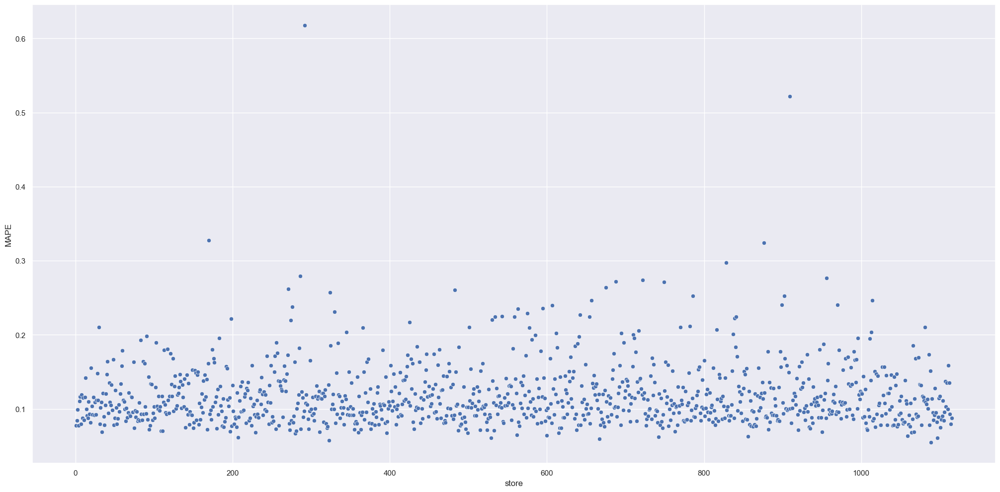

In [114]:
sns.scatterplot( x='store', y='MAPE', data=df72 )

## 9.2. Total Performance

In [115]:
df73 = df72[['predictions', 'worst_scenario', 'best_scenario']].apply( lambda x: np.sum( x ), axis=0 ).reset_index().rename( columns={'index': 'Scenario', 0:'Values'} )
df73['Values'] = df73['Values'].map( 'R${:,.2f}'.format )
df73

,Scenario,Values
0,predictions,"R$290,155,328.00"
1,worst_scenario,"R$289,287,136.61"
2,best_scenario,"R$291,023,555.53"


## 9.3. Machine Learning Performance

In [116]:
df7["error"] = df7["sales"] - df7["predictions"]
df7["error_rate"] = df7["predictions"] / df7["sales"]

In [117]:
df7.head(1)

,store,promo,store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,promo2,promo2_since_week,promo2_since_year,competition_time_month,promo_time_week,day_of_week_cos,day_of_week_sin,month_cos,day_cos,day_sin,year_of_week_cos,date,sales,predictions,error,error_rate
0,1,1,2,1,-0.170968,9,2008,0,31,2015,-0.918919,0.287016,-0.222521,-0.974928,-0.866025,0.978148,0.207912,-0.822984,2015-07-31,5263.0,6105.94043,-842.94043,1.160163


<AxesSubplot: xlabel='date', ylabel='sales'>

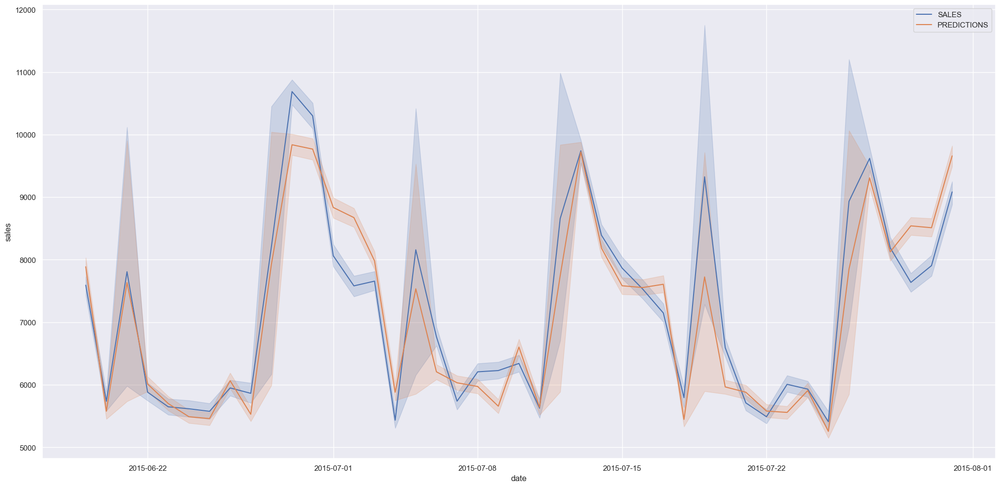

In [129]:
sns.lineplot(x="date",y="sales",data=df7,label="SALES")
sns.lineplot(x="date",y="predictions",data=df7,label="PREDICTIONS")

<AxesSubplot: xlabel='predictions', ylabel='error'>

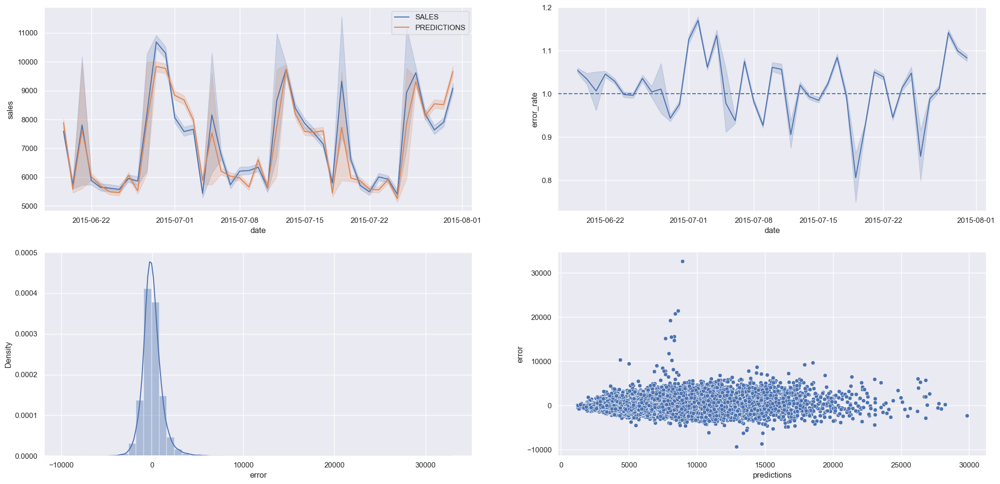

In [118]:
plt.subplot(2,2,1) 
sns.lineplot(x="date",y="sales",data=df7,label="SALES")
sns.lineplot(x="date",y="predictions",data=df7,label="PREDICTIONS")

plt.subplot(2,2,2)
sns.lineplot( x='date', y='error_rate', data=df7)
plt.axhline( 1, linestyle='--')

plt.subplot( 2, 2, 3 )
sns.distplot( df7['error'] )

plt.subplot( 2, 2, 4 )
sns.scatterplot(x=df7['predictions'], y=df7['error'],data=df7) 

# 10.0. PASSO 10 - DEPLOY MODEL TO PRODUCTION


## 10.1  Rossmann Class

In [119]:
# import pickle
# import inflection
# import pandas as pd
# import numpy as np
# import math
# import datetime

# class Rossmann (object):
#     def __init__(self):
#         self.competition_distance_scaler   = pickle.load(open(r"C:\Users\Douglas\Documents\repos\datascience_em_producao\parameter\competition_distance_scaler.pkl","rb"))
#         self.competition_time_month_scaler = pickle.load(open(r"C:\Users\Douglas\Documents\repos\datascience_em_producao\parameter\competition_time_month_scaler.pkl","rb"))
#         self.promo_time_week_scaler        = pickle.load(open(r"C:\Users\Douglas\Documents\repos\datascience_em_producao\parameter\promo_time_week_scaler.pkl","rb"))      
#         self.year_scaler                   = pickle.load(open(r"C:\Users\Douglas\Documents\repos\datascience_em_producao\parameter\year_scaler.pkl","rb"))
#         self.store_type_scaler             = pickle.load(open(r"C:\Users\Douglas\Documents\repos\datascience_em_producao\parameter\store_type_scaler.pkl","rb")) 
#         def data_cleaning(self,df1):            
#             ## 1.1 Rename Columns
#             cols_old = ['Store','DayOfWeek','Date','Open','Promo','StateHoliday','SchoolHoliday','StoreType','Assortment','CompetitionDistance','CompetitionOpenSinceMonth','CompetitionOpenSinceYear','Promo2','Promo2SinceWeek','Promo2SinceYear','PromoInterval']
#             snakecase = lambda x : inflection.underscore(x)
#             cols_new = list(map(snakecase,cols_old))
#             df1.columns= cols_new   
#             df1.date = pd.to_datetime(df1.date)  
#             ## 1.5 Fillout NAN
#             # competition_distance     
#             df1["competition_distance"] = df1["competition_distance"].apply (lambda x: 200000.0 if pd.isna(x) else x)
#             # competition_open_since_month    
#             df1["competition_open_since_month"] = df1.apply(lambda x: x["date"].month if pd.isnull(x["competition_open_since_month"]) else x["competition_open_since_month"],axis=1)
#             # competition_open_since_year     
#             df1["competition_open_since_year"] = df1.apply(lambda x: x["date"].year if pd.isnull(x["competition_open_since_year"]) else x["competition_open_since_year"],axis=1)
#             # promo2_since_week 
#             df1["promo2_since_week"] = df1.apply(lambda x: x["date"].week if pd.isnull(x["promo2_since_week"]) else x["promo2_since_week"],axis=1)
#             # promo2_since_year   
#             df1["promo2_since_year"] = df1.apply(lambda x: x["date"].year if pd.isnull(x["promo2_since_year"]) else x["promo2_since_year"],axis=1) 
#             # promo_interval                 
#             month_map = {1:"Jan",2:"Fev",3:"Mar",4:"Apr",5:"May",6:"Jun",7:"Jul",8:"Aug",9:"Sept",10:"Oct",11:"Nov",12:"Dec"}
#             df1["promo_interval"].fillna(0,inplace=True)
#             df1["month_map"] = df1["date"].dt.month.map(month_map)
#             df1["is_promo"] = df1[["promo_interval","month_map"]].apply(lambda x: 0 if x["promo_interval"] ==0 else 1 if x["month_map"] in x["promo_interval"].split(",") else 0,axis=1)
#             ## 1.6 Change Data Types
#             # competiton
#             colunas =["competition_open_since_month","competition_open_since_year","promo2_since_week","promo2_since_year"]
#             for coluna in colunas:
#                 df1[coluna] = df1[coluna].astype(int)
#             return df1
        
#         def feature_engineering(self,df2):
#              # year
#             df2["year"] = df2["date"].dt.year
#             # month
#             df2["month"] = df2["date"].dt.month
#             # day
#             df2["day"] = df2["date"].dt.day
#             # week of year
#             df2["year_of_week"] = df2["date"].dt.weekofyear
#             # year week
#             df2["year_week"] = df2["date"].dt.strftime("%Y-%W")
#             # competition since
#             df2["competition_since"] = df2.apply(lambda x :datetime.datetime(year=x["competition_open_since_year"],month=x["competition_open_since_month"],day=1),axis=1)
#             df2["competition_time_month"] = ((df2["competition_since"] - df2["date"]) /30) .apply(lambda x: x.days).astype(int)
#             # promo since
#             df2['promo_since'] = df2['promo2_since_year'].astype( str ) + '-' + df2['promo2_since_week'].astype( str )
#             df2['promo_since'] = df2['promo_since'].apply( lambda x: datetime.datetime.strptime( x + '-1', '%Y-%W-%w' ) - datetime.timedelta( days=7 ) )
#             df2['promo_time_week'] = ( ( df2['date'] - df2['promo_since'] )/7 ).apply( lambda x: x.days ).astype( int )
#             # assortment a=básico,b=extra,c=estendido
#             df2["assortment"]= df2["assortment"].apply(lambda x: "basic" if x=="a" else "extra" if x=="b" else "extend")
#             # state holiday  a = public holiday, b = Easter holiday, c = Christmas, 0 = Nenhum
#             df2['state_holiday'] = df2['state_holiday'].apply( lambda x: 'public_holiday' if x == 'a' else 'easter_holiday' if x == 'b' else 'christmas' if x == 'c' else 'regular_day' )
#             df2= df2[df2.open != 0]
#             ## 3.2 Seleção de Colunas
#             cols_drop = ["open","promo_interval","month_map"]
#             df2 = df2.drop(cols_drop,axis=1)
#             return df2
#         def data_preparation(self,df5):
#             # competition_distance
#             df5["competition_distance"]= self.competition_distance_scaler.fit_transform(df5["competition_distance"].values.reshape(-1, 1))
#             # competition_time_month
#             df5["competition_time_month"] = self.competition_time_month_scaler.fit_transform(df5["competition_time_month"].values.reshape(-1,1))            
#             # promo_time_week            
#             df5["promo_time_week"] = self.promo_time_week_scaler.fit_transform(df5["promo_time_week"].values.reshape(-1,1))
#             # year
#             df5["year"] = self.year_scaler.fit_transform(df5[["year"]].values)
#             # state_holiday - One Hot Encoding
#             df5 = pd.get_dummies( df5, prefix=['state_holiday'], columns=['state_holiday'] )
#             # store_type - Label Encoding            
#             df5["store_type"] = self.store_type_scaler.fit_transform(df5["store_type"])
#             # assortment - Ordinal Encoding
#             dic = {"basic":1,"extra":2,"extend":3}
#             df5["assortment"] = df5["assortment"].map(dic)            
#             #day_of_week
#             df5["day_of_week_cos"] = df5["day_of_week"].apply(lambda x: np.cos( x * (2. * np.pi/7 )))
#             df5["day_of_week_sin"] = df5["day_of_week"].apply(lambda x: np.sin( x *  (2. * np.pi/7)))                                                  
#             #month
#             df5["month_cos"] = df5["month"].apply(lambda x: np.cos( x * (2. * np.pi/12)))
#             df5["month_sin"] = df5["month"].apply(lambda x: np.sin( x * (2. * np.pi/12)))                                                   
#             #day
#             df5["day_cos"] = df5["day"].apply(lambda x: np.cos( x * (2. * np.pi/30 )))
#             df5["day_sin"] = df5["day"].apply(lambda x: np.sin( x * (2. * np.pi/30 )))                                      
#             #year_of_week
#             df5["year_of_week_cos"] = df5["year_of_week"].apply(lambda x: np.cos( x * (2. * np.pi/52)))
#             df5["year_of_week_sin"] = df5["year_of_week"].apply(lambda x: np.sin( x * (2. * np.pi/52)))
#             cols_selected = ['store','promo','store_type','assortment', 'competition_distance', 'competition_open_since_month','competition_open_since_year','promo2','promo2_since_week','promo2_since_year','competition_time_month','promo_time_week', 'day_of_week_cos', 'day_of_week_sin','month_cos', 'day_cos', 'day_sin', 'year_of_week_cos']            
#             return df5[cols_selected]
#         def get_predictions(self,model,origin_data,data_test):
#             pred = model.predict(data_test)
#             origin_data["prediction"]= np.exp1(pred)
#             return origin_data.to_json(orient="records",date_format="iso")

# 10.2  API Handler

In [120]:
# import pickle
# import pandas as pd
# from flask             import Flask, request, Response
# from rossmann.Rossmann import Rossmann


# # loading model
# model = pickle.load(open(r"C:/Users/Douglas/Documents/repos/datascience_em_producao/parameter/maquina_preditiva.pkl","rb"))

# app=Flask(__name__)
# @app.route("/rossmann/predict",methods=["POST"])
# def rossmann_predict():
#     test_json = request.get_json()
#     if test_json: #there is data(se existir dados)
#         if isinstance(test_json, dict): # unique example
#             test_raw = pd.DataFrame(test_json,index=[0])
#         else: # unique example
#             test_raw = pd.DataFrame(test_json,columns=test_json[0].keys())
#         # Instantiate Rossmann class
#         pipeline = Rossmann(object)
#         # data cleaning
#         df1 = pipeline.data_cleaning(test_raw)
#         # feature engineering
#         df2 = pipeline.feature_engineering(df1)
#         # data preparation
#         df3 = pipeline.data_preparation(df2)
#         # prediction
#         df_response = pipeline.get_prediction(model,test_raw,df3)
#         return df_response        
#     else:
#         return Response("{}",status=200,mimetype="application/json")
# if __name__=="__main__": 
#      app.run("192.168.0.107")

# API TESTER

In [121]:
import pandas as pd 
df10 = pd.read_csv(r"C:/Users/Douglas/Documents/repos/datascience_em_producao/data/test.csv") 
df_store_raw = pd.read_csv(r"C:/Users/Douglas/Documents/repos/datascience_em_producao/data/store.csv") 

In [122]:
df_test =pd.merge(df10,df_store_raw,how="left",on="Store")

In [123]:
df_test.head(1)

,Id,Store,DayOfWeek,Date,Open,Promo,StateHoliday,SchoolHoliday,StoreType,Assortment,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval
0,1,1,4,2015-09-17,1.0,1,0,0,c,a,1270.0,9.0,2008.0,0,NaN,NaN,NaN


In [124]:
#choose store for prediction
df_test = df_test[df_test["Store"].isin([22])]
df_test = df_test[df_test["Open"]!=0]
df_test = df_test[~df_test["Open"].isnull()]
df_test = df_test.drop("Id",axis="columns")


In [125]:
# convert Dataframe to Json
data = json.dumps(df_test.to_dict( orient='records' ) )
data 



'[{"Store": 22, "DayOfWeek": 4, "Date": "2015-09-17", "Open": 1.0, "Promo": 1, "StateHoliday": "0", "SchoolHoliday": 0, "StoreType": "a", "Assortment": "a", "CompetitionDistance": 1040.0, "CompetitionOpenSinceMonth": NaN, "CompetitionOpenSinceYear": NaN, "Promo2": 1, "Promo2SinceWeek": 22.0, "Promo2SinceYear": 2012.0, "PromoInterval": "Jan,Apr,Jul,Oct"}, {"Store": 22, "DayOfWeek": 3, "Date": "2015-09-16", "Open": 1.0, "Promo": 1, "StateHoliday": "0", "SchoolHoliday": 0, "StoreType": "a", "Assortment": "a", "CompetitionDistance": 1040.0, "CompetitionOpenSinceMonth": NaN, "CompetitionOpenSinceYear": NaN, "Promo2": 1, "Promo2SinceWeek": 22.0, "Promo2SinceYear": 2012.0, "PromoInterval": "Jan,Apr,Jul,Oct"}, {"Store": 22, "DayOfWeek": 2, "Date": "2015-09-15", "Open": 1.0, "Promo": 1, "StateHoliday": "0", "SchoolHoliday": 0, "StoreType": "a", "Assortment": "a", "CompetitionDistance": 1040.0, "CompetitionOpenSinceMonth": NaN, "CompetitionOpenSinceYear": NaN, "Promo2": 1, "Promo2SinceWeek": 22.

In [126]:
# API Call
#url = 'http://192.168.0.104:5000/rossmann/predict'
url = 'https://api-rossmann-render-x8ik.onrender.com/rossmann/predict'
#url = 'https://rossmann-telegram-bot-7jmy.onrender.com/rossmann/predict'
header = {'Content-type':'application/json'} 
data = data
r = requests.post(url,data=data,headers=header )
print( 'Status Code {}'.format(r.status_code)) 


Status Code 200


In [127]:
df = pd.DataFrame(r.json(),columns=r.json()[0].keys())
df.head()

,store,day_of_week,date,open,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,promo2,promo2_since_week,promo2_since_year,promo_interval,month_map,is_promo,year,month,day,year_week,competition_since,competition_time_month,promo_since,promo_time_week,prediction
0,22,4,2015-09-17T00:00:00.000,1.0,1,regular_day,0,a,basic,1040.0,9,2015,1,22,2012,"Jan,Apr,Jul,Oct",Sept,0,2015,9,17,38,2015-09-01T00:00:00.000,-1,2012-05-21T00:00:00.000,173,5154.709961
1,22,3,2015-09-16T00:00:00.000,1.0,1,regular_day,0,a,basic,1040.0,9,2015,1,22,2012,"Jan,Apr,Jul,Oct",Sept,0,2015,9,16,38,2015-09-01T00:00:00.000,-1,2012-05-21T00:00:00.000,173,5217.240234
2,22,2,2015-09-15T00:00:00.000,1.0,1,regular_day,0,a,basic,1040.0,9,2015,1,22,2012,"Jan,Apr,Jul,Oct",Sept,0,2015,9,15,38,2015-09-01T00:00:00.000,-1,2012-05-21T00:00:00.000,173,6294.251953
3,22,1,2015-09-14T00:00:00.000,1.0,1,regular_day,1,a,basic,1040.0,9,2015,1,22,2012,"Jan,Apr,Jul,Oct",Sept,0,2015,9,14,38,2015-09-01T00:00:00.000,-1,2012-05-21T00:00:00.000,173,7099.746582
4,22,6,2015-09-12T00:00:00.000,1.0,0,regular_day,0,a,basic,1040.0,9,2015,1,22,2012,"Jan,Apr,Jul,Oct",Sept,0,2015,9,12,37,2015-09-01T00:00:00.000,-1,2012-05-21T00:00:00.000,172,2925.998779


In [128]:
df1 = df[["store","prediction"]].groupby("store").sum().reset_index()  
#df1 
for i in range(len(df1)):
    print("Store number {} will sel R${:,.2f} in the next 6 weeks".format(df1.loc[i,"store"],df1.loc[i,"prediction"]))

Store number 22 will sel R$178,247.57 in the next 6 weeks


In [ ]:
import json
import requests


token="6821240818:AAGyOtpksA6JhwqIlTwaQcw4sU3djWVPpD0"

def send_message( chat_id, text ):
    url = 'https://api.telegram.org/bot{}/'.format( token ) 
    url = url + 'sendMessage?chat_id={}'.format( chat_id ) 
    r = requests.post( url, json={'text': text } )
    print( 'Status Code {}'.format( r.status_code ) )
    print(r.text)
    return None
msg =  send_message(1226335433,22)
#print(msg)

In [ ]:
import json
import requests


token="6821240818:AAGyOtpksA6JhwqIlTwaQcw4sU3djWVPpD0"


def send_message(chat_id, text):
    url =f"https://api.telegram.org/bot{token}/sendMessage?chat_id={chat_id}"
    r = requests.post(url,json={"text":text} )
    print("Status Code {}".format(r.status_code))
    print(r.text)
    return None 

message = send_message(1226335433,22)
print(message)


#msg = send_message_(1226335433,22)
#print(msg)

# msg={"ok":True,"result":{"message_id":9,"from":{"id":6236253743,"is_bot":True,"first_name":"RossmannBot","username":"predict_rosman_bot"},"chat":{"id":1226335433,"first_name":"Douglas","last_name":"Silva","type":"private"},"date":1677598856,"text":"Teste"}} 
# #print(msg["result"]["chat"]["id"])
# print(msg["result"]["text"])
# def parse_message(message):
#     chat_id = message["chat"]["id"]
#     store_id = message["date"]["text"]
#     store_id = store_id.replace("/"," ")
#     try:
#         store_id = int(store_id) 
#     except ValueError:        
#         store_id="error"
#     return chat_id,store_id
# parse_message(message)

In [ ]:
msg ={"ok":True,"result":{"message_id":26,"from":{"id":6236253743,"is_bot":True,"first_name":"RossmannBot","username":"predict_rosman_bot"},"chat":{"id":1226335433,"first_name":"Douglas","last_name":"Silva","type":"private"},"date":1678116696,"text":"22"}} 
# print(msg["result"]["chat"]["id"])
# print(msg["result"]["text"])
def parse_message(message):
    chat_id = message["result"]["chat"]["id"]
    store_id = message["result"]["text"]
    store_id = store_id.replace("/"," ")
    try:
        store_id = int(store_id) 
    except ValueError:        
        store_id="error"
    return chat_id,store_id
parse_message(msg)
